<a href="https://colab.research.google.com/github/The-One-Program/FiNNiGAN-Implementation/blob/main/FINNIGAN_1_0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Cloining The Repoistory to Colab:

In [2]:
! git clone https://github.com/The-One-Program/FiNNiGAN-Implementation.git

Cloning into 'FiNNiGAN-Implementation'...
remote: Enumerating objects: 87, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 87 (delta 0), reused 2 (delta 0), pack-reused 82
Unpacking objects: 100% (87/87), 49.45 MiB | 9.87 MiB/s, done.


# Importing and Installing Dependencies:

In [3]:
!pip install pytorch-msssim
import os
import cv2
import shutil # For Deleting the Non-Empty Directory fromo colab
from google.colab.patches import cv2_imshow
import torch 
import torch.nn as nn
import torch.optim as optim
import torchvision 
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torch.utils.tensorboard import SummaryWriter

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
%cd FiNNiGAN-Implementation

/content/FiNNiGAN-Implementation


# Script for Writing each frame data into the 'output' directory:


In [5]:
# Extracting The Frames:
VidDirectory = os.path.join('data','Videos') # --> os.path.join('data','Videos')
# Will be the absolute path:
Abs_DatasetPath = "/content/FiNNiGAN-Implementation/data/output/" # --> "C:/.../FiniGAN/data/output/"
#Will be a relative path:
Rel_DatasetPath = os.path.join('data','output') # --> os.path.join('data','output')

directory = os.fsencode(VidDirectory)


def saveFrame(success,img,dirname,name):
    if success:
        result=cv2.imwrite(Abs_DatasetPath+dirname+'/'+name,img)
        print(Abs_DatasetPath+dirname+'/'+name)
    if result==True:
        print('File saved successfully')
    else:
        print('Error in saving file')


cnt = -1
def VidCap(VidPath,count):
    cap = cv2.VideoCapture(VidPath)

    for frame_idx in range((int(cap.get(cv2.CAP_PROP_FRAME_COUNT))//3)*3):
        # Read Frame:
        success,frame = cap.read()
        global cnt 
        if((frame_idx%3)==0):
            cnt += 1
            dir_path = os.path.join(Rel_DatasetPath,'data'+str(cnt))
            
            # if os.path.exists(dir_path): # Set-ExecutionPolicy Unrestricted
            #     os.remove(dir_path) 
            """Above Removal Not working, reason is not clear"""
            
            # Create a directory as data_i: 
            os.mkdir(dir_path) 
            # Add current frame also to the directory
            saveFrame(success,frame,'data'+str(cnt),'frame1.png')

        elif((frame_idx%3)==1):
            # Add current Frame to the directory
            saveFrame(success,frame,'data'+str(cnt),'frame2.png')

        else:
            # Add current Frame to the directory
            saveFrame(success,frame,'data'+str(cnt),'frame3.png')

        # Rendering The Processing Video
        # cv2_imshow(frame)
        if cv2.waitKey(10) & 0xFF == ord('q'):
            break

    # Close down Everything and release Video Writer:
    cap.release()
    cv2.destroyAllWindows()
    
os.listdir(directory)

[b'vid1.y4m', b'vid0.y4m']

# Generating frames from the videos:


In [6]:
# shutil. rmtree(os.path.join('data','output'))

In [7]:
# Iterating The Videos containing Directory
outcount = 0
for file in os.listdir(directory):
    filename = os.fsdecode(file)
    file_path = os.path.join(VidDirectory,filename)
    VidCap(file_path,outcount)
    print(filename)
    outcount+=1

/content/FiNNiGAN-Implementation/data/output/data0/frame1.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data0/frame2.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data0/frame3.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data1/frame1.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data1/frame2.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data1/frame3.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data2/frame1.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data2/frame2.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data2/frame3.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data3/frame1.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data3/frame2.png
File saved successfully
/content/FiNNiGAN-Implementation/data/output/data3/fra

# Importing the Model

In [27]:
from model import Discriminator, UNET, initialize_weights
from FinniDataset import FinniGANDataset
from pytorch_msssim import ssim, ms_ssim, SSIM, MS_SSIM

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Fixing Hyperparms, Loading data and Initializing The model:

In [28]:
# Hyperparams:
Lr = 2e-4
Batch_size = 32
Image_size = 256 # To be taken Care of !!
Channel_img = 3
Num_Epochs = 64
# Features_Disc = 160
# Features_Gen = 160
Stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

# Appling the Transforms:
CustomTransform = transforms.Compose(
    [
        transforms.Resize((Image_size,Image_size)),
        transforms.ToTensor(),
        transforms.Normalize(
            [0.5 for _ in range(Channel_img)], [0.5 for _ in range(Channel_img)]
        )
    ]
)

In [29]:
# Load Data:
dataset = FinniGANDataset(root_dir = os.path.join('data', 'output'), transform=CustomTransform)
datalen = len(dataset)
print(datalen)
train_set, test_set = torch.utils.data.random_split(dataset, [int(0.8*datalen),datalen-int(0.8*datalen)])
train_loader = DataLoader(dataset=train_set, batch_size=Batch_size, shuffle=True)
test_loader = DataLoader(dataset=test_set, batch_size=Batch_size, shuffle=True)

150


In [30]:
# Initializing The Model:
gen = UNET(in_channels=3,out_channels=3).to(device)
disc = Discriminator(in_channels=3).to(device)
initialize_weights(gen)
initialize_weights(disc)

# Using different optimisers for gen and disc:
opt_gen = optim.Adam(gen.parameters(), lr=0.001, betas=(0.9, 0.999), eps=1e-08, weight_decay=0) # Betas Can be changed:
opt_disc = optim.Adam(disc.parameters(), lr=0.001, betas=(0.9, 0.999), eps=1e-08, weight_decay=0) # Betas Can be changed:

# Defining the Loss for Generator and Discriminator:
binary_cross_entropy = nn.BCELoss()
l1_loss = nn.L1Loss()
clipping_loss = nn.MSELoss()

# Telling the activation and other optimization layers to work:
gen.train()
disc.train()

Discriminator(
  (dis): Sequential(
    (0): Conv2d(3, 8, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
    (3): Conv2d(8, 16, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2)
    (6): Conv2d(16, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2)
    (9): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2)
    (12): Conv2d(64, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (13): BatchNorm2d(1, eps=1e-05, momentum=0.1, affine=True, track_running_st

In [31]:
def denorm(img_tensor):
    return img_tensor*Stats[1][0] + Stats[0][0]

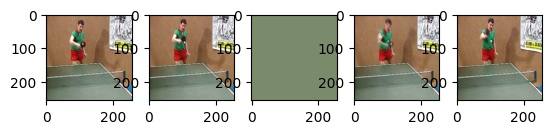

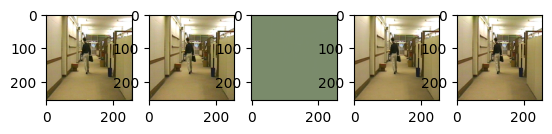

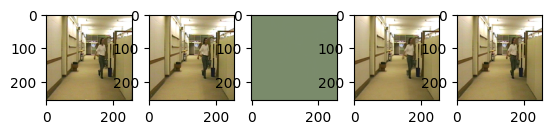

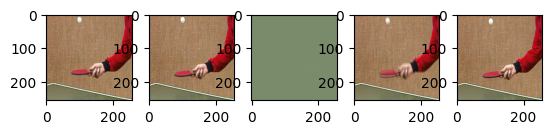

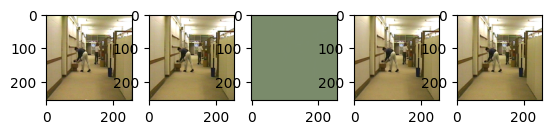

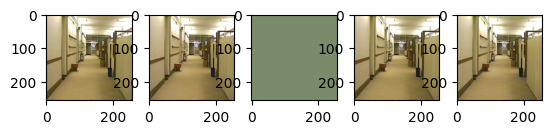

In [32]:
def showImg(idx):
    t1,t2,Img1,Img2 = test_set[idx]
    t1.to(device)
    t2.to(device)
    Img1.to(device)
    Img2.to(device)
    T1 = torch.unsqueeze(t1,dim=0).to(device)

    genout = gen(T1).to(device)
    genout = torch.squeeze(genout,dim=0).to(device)

    f , axarr = plt.subplots(1,5)
    axarr[0].imshow(denorm(Img1).permute(1,2,0))
    axarr[1].imshow(denorm(t2).permute(1,2,0))
    with torch.no_grad():
        axarr[2].imshow(denorm(genout.to('cpu')).permute(1,2,0))
    axarr[3].imshow(denorm(t1).permute(1,2,0))
    axarr[4].imshow(denorm(Img2).permute(1,2,0))

    f.show()
    plt.show(block=True)

for i in range(int(len(test_set)*0.2)):
    showImg(i)
    # break

# Training The discriminator:


In [33]:
# Training the Discriminator:

def train_discriminator(f1_f3_images,real_images, opt_d):

    # Pass real images through discriminator
    real_preds = disc(real_images).reshape(-1)
    # real_targets = torch.ones(Batch_size, 1, device=device)
    real_loss = binary_cross_entropy(real_preds, torch.ones_like(real_preds,device=device))
    real_score = torch.mean(real_preds).item()

    # Generate fake images
    fake_images = gen(f1_f3_images)

    # Pass fake images through dicriminator
    # fake_targets = torch.zeros(Batch_size, 1, device=device)
    fake_preds = disc(fake_images).reshape(-1)
    fake_loss = binary_cross_entropy(fake_preds,torch.zeros_like(fake_preds,device=device))
    fake_score = torch.mean(fake_preds).item()

    print('RealLoss=',real_loss,'FakeLoss=',fake_loss)
    # Update discriminator weights
    loss = real_loss + fake_loss
    # Clear Discriminator gradients
    disc.zero_grad()
    loss.backward()
    opt_d.step()

    return loss.item(), real_score, fake_score

# Training the Generator:

In [34]:
# Training the Generator:
# def stack(img1,img2,img3):

def MS_SSIMTransform(Img):
    ToGray = transforms.Grayscale()
    # Img = torch.clamp(Img,min = 0, max = 1)
    Img = (Img + 1) /2
    # Img = ToGray(Img)
    return Img

def MSSSIM(pred,orignal):
    pred = MS_SSIMTransform(pred)
    orignal = MS_SSIMTransform(orignal)
    ms_ssim_loss = 1-ms_ssim( pred, orignal, data_range=1, size_average=True )# See if clipping Helps!!! that is if data_range = 1 helps
    return ms_ssim_loss
         
def train_generator(f1_f3_images,real_images,opt_g):

    # Generate fake images
    fake_images = gen(f1_f3_images) # each val is between [-1,1]

    # Try to fool the discriminator
    preds = disc(fake_images).reshape(-1) # Size is equal to that of Batch
    print('preds:',preds)

    # Losses:

    # Discriminator Loss:
    DISC_LOSS = binary_cross_entropy(preds, torch.ones_like(preds,device=device))

    # l1 Loss:
    L1_LOSS = l1_loss(fake_images,real_images)

    # MS-SSIM Loss:
    Normalize = transforms.Normalize([0.5 for _ in range(Channel_img)], [0.5 for _ in range(Channel_img)])

    # MS_SSIM_LOSS = MSSSIM(PREDclippedIMG,real_images)
    MS_SSIM_LOSS = MSSSIM(fake_images,real_images)

    # Clipping Loss:
    CLIPPING_LOSS = clipping_loss(torch.clamp(fake_images,min = 0,max = 1),fake_images)

    # Update generator weights
    loss = DISC_LOSS + L1_LOSS + MS_SSIM_LOSS + CLIPPING_LOSS
    print('TotalGEN_LOSS=',loss,'MSSSIM=',MS_SSIM_LOSS,'Clip=',CLIPPING_LOSS)
    # Clear generator gradients
    gen.zero_grad()
    loss.backward()
    opt_g.step()

    return loss.item()

# Training:

In [35]:
# Training :
def train(epochs,lr,start_idx=1):
    if torch.cuda.is_available:
        torch.cuda.empty_cache()

    # Losses & scores:
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []

    for epoch in range(epochs):
        for batch_idx,(stkIMG,middleIMG,_,_) in enumerate(train_loader):
            stkIMG, middleIMG = stkIMG.to(device), middleIMG.to(device)
            # Train Discriminator: 
            loss_d, real_score, fake_score = train_discriminator(stkIMG,middleIMG,opt_disc)
            # Train generator:
            loss_g = train_generator(stkIMG,middleIMG,opt_gen)

        # Record losses & scores
        losses_g.append(loss_g)
        losses_d.append(loss_d)
        real_scores.append(real_score)
        fake_scores.append(fake_score)

        # Log losses & scores (last batch)
        print ("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_scores: {:.4f}, fake_scores: {:.4f}".format(epoch+1,epochs,loss_g,loss_d,real_score,fake_score))
        for i in range(int(len(test_set)*0.2)):
          showImg(i)  

    return losses_g, losses_d, real_scores, fake_scores

RealLoss= tensor(0.6766, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6960, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5017, 0.5017, 0.5017, 0.5017, 0.5016, 0.5015, 0.5017, 0.5017, 0.5017,
        0.5017, 0.5017, 0.5015, 0.5016, 0.5026, 0.5016, 0.5017, 0.5015, 0.5018,
        0.5016, 0.5016, 0.5015, 0.5016, 0.5016, 0.5021, 0.5016, 0.5014, 0.5040,
        0.5017, 0.5016, 0.5016, 0.5021, 0.5015], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.7641, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.7362, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0084, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.6610, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6966, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5013, 0.5013, 0.5010, 0.5010, 0.5021, 0.5016, 0.5032, 0.5010, 0.5009,
        0.5010, 0.5016, 0.5010, 0.

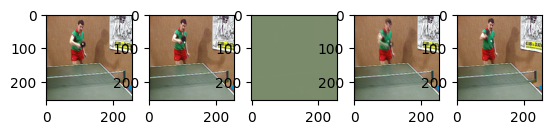

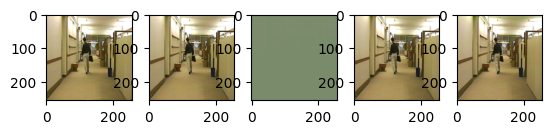

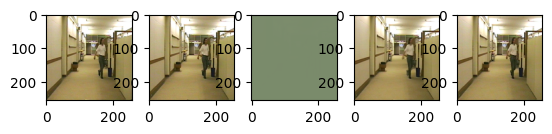

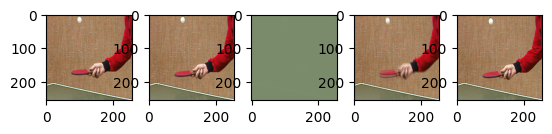

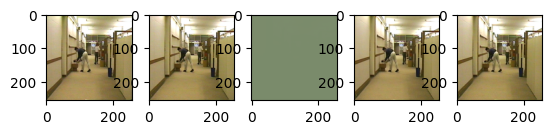

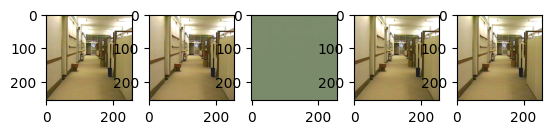

RealLoss= tensor(0.6464, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.7006, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5012, 0.5013, 0.5012, 0.5012, 0.5013, 0.5012, 0.5012, 0.5014, 0.5014,
        0.5013, 0.5012, 0.5012, 0.5012, 0.5013, 0.5013, 0.5012, 0.5014, 0.5013,
        0.5014, 0.5012, 0.5012, 0.5012, 0.5018, 0.5013, 0.5016, 0.5023, 0.5014,
        0.5014, 0.5018, 0.5013, 0.5012, 0.5012], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.7899, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.7513, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0084, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.6460, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6990, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5014, 0.5012, 0.5012, 0.5013, 0.5012, 0.5012, 0.5012, 0.5012, 0.5012,
        0.5012, 0.5011, 0.5012, 0.

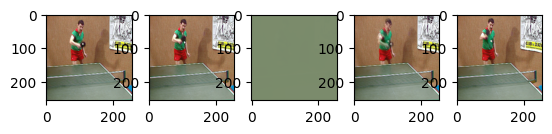

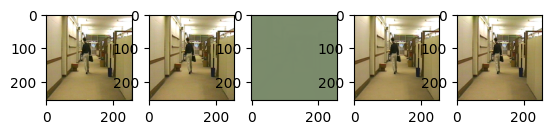

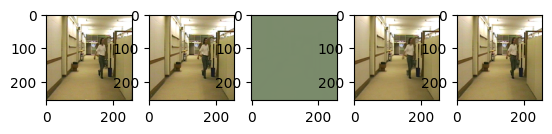

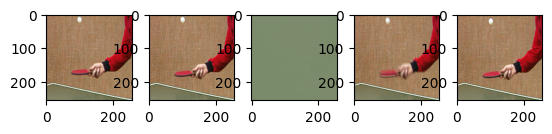

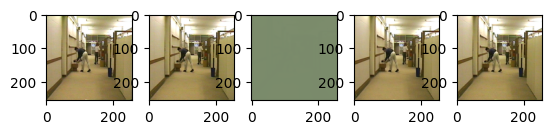

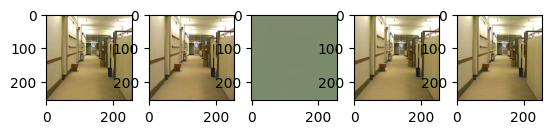

RealLoss= tensor(0.6377, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6953, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5012, 0.5012, 0.5012, 0.5013, 0.5012, 0.5014, 0.5013, 0.5013, 0.5013,
        0.5013, 0.5012, 0.5013, 0.5012, 0.5012, 0.5012, 0.5012, 0.5013, 0.5013,
        0.5012, 0.5012, 0.5013, 0.5013, 0.5013, 0.5013, 0.5012, 0.5013, 0.5013,
        0.5013, 0.5013, 0.5013, 0.5013, 0.5012], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.7938, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.7534, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0084, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.6414, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6957, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5009, 0.5010, 0.5009, 0.5009, 0.5009, 0.5009, 0.5009, 0.5009, 0.5010,
        0.5009, 0.5009, 0.5009, 0.

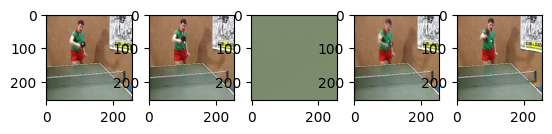

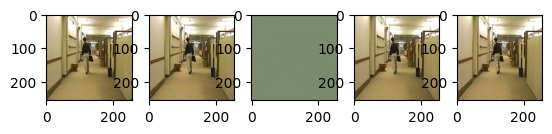

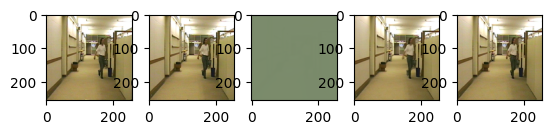

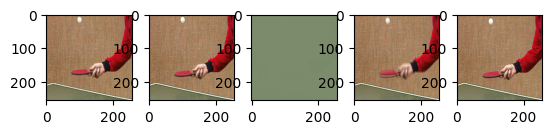

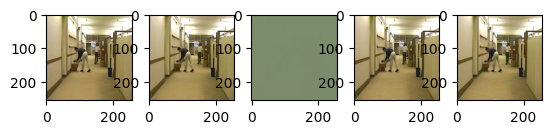

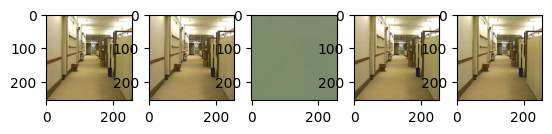

RealLoss= tensor(0.6343, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6950, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5007, 0.5008, 0.5007, 0.5007, 0.5008, 0.5008, 0.5007, 0.5008, 0.5007,
        0.5007, 0.5006, 0.5006, 0.5007, 0.5007, 0.5006, 0.5007, 0.5007, 0.5007,
        0.5008, 0.5007, 0.5007, 0.5006, 0.5006, 0.5006, 0.5008, 0.5007, 0.5006,
        0.5007, 0.5008, 0.5007, 0.5006, 0.5006], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.7598, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.7270, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0085, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.6313, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6946, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5006, 0.5006, 0.5006, 0.5006, 0.5006, 0.5006, 0.5006, 0.5006, 0.5006,
        0.5006, 0.5006, 0.5005, 0.

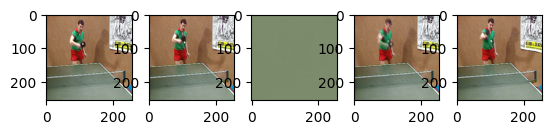

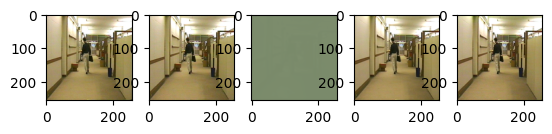

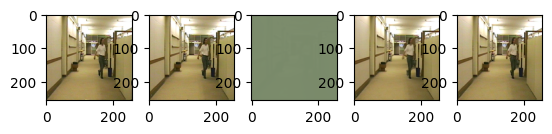

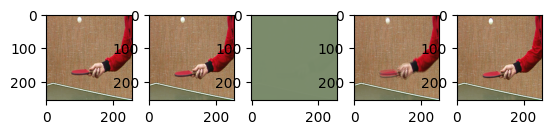

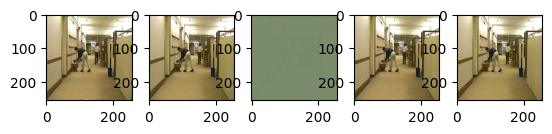

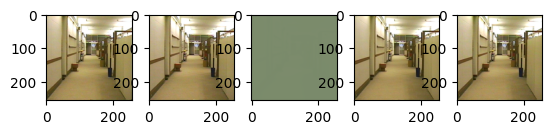

RealLoss= tensor(0.6301, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6937, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5008, 0.5006, 0.5008, 0.5007, 0.5012, 0.5008, 0.5006, 0.5007, 0.5008,
        0.5008, 0.5006, 0.5006, 0.5008, 0.5008, 0.5008, 0.5007, 0.5006, 0.5008,
        0.5007, 0.5008, 0.5006, 0.5008, 0.5008, 0.5007, 0.5008, 0.5006, 0.5006,
        0.5006, 0.5008, 0.5008, 0.5008, 0.5008], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.7121, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6939, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0085, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.6280, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6946, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5003, 0.5002, 0.5003, 0.5002, 0.5005, 0.5003, 0.5002, 0.5002, 0.5003,
        0.5002, 0.5002, 0.5002, 0.

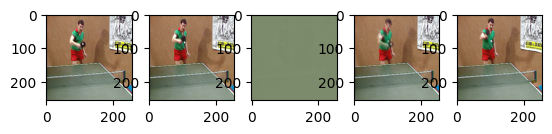

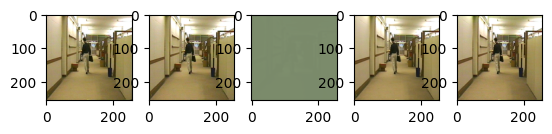

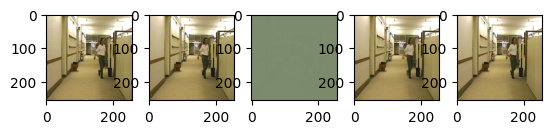

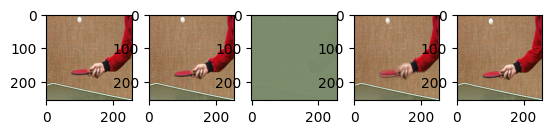

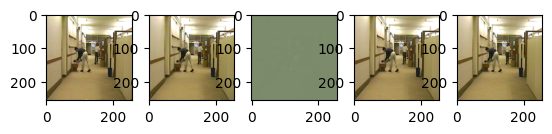

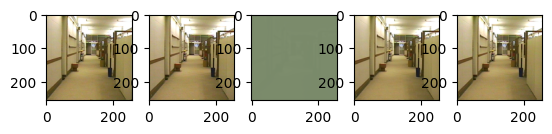

RealLoss= tensor(0.6200, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6944, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5001, 0.5001, 0.5002, 0.5001, 0.5003, 0.5005, 0.5001,
        0.5003, 0.5001, 0.5002, 0.5002, 0.5002, 0.5011, 0.5007, 0.5001, 0.5001,
        0.5005, 0.5003, 0.5002, 0.5001, 0.5003, 0.5003, 0.5001, 0.5002, 0.5001,
        0.5004, 0.5001, 0.5001, 0.5001, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.7410, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.7130, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0086, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.6252, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6937, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5004, 0.5000, 0.5000, 0.5002, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5001, 0.5001, 0.

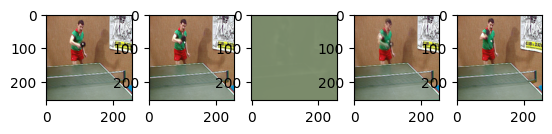

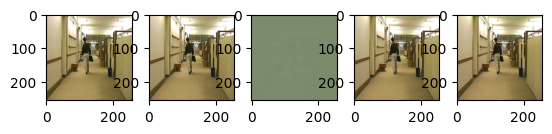

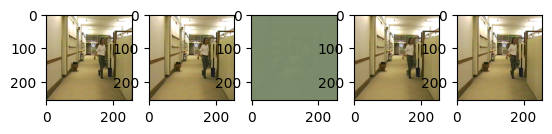

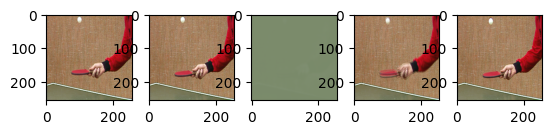

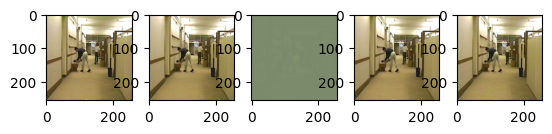

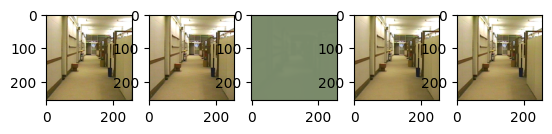

RealLoss= tensor(0.6185, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6938, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5006, 0.5006, 0.5006, 0.5007, 0.5006, 0.5006, 0.5006, 0.5006, 0.5006,
        0.5006, 0.5006, 0.5006, 0.5006, 0.5005, 0.5006, 0.5007, 0.5006, 0.5006,
        0.5006, 0.5006, 0.5006, 0.5006, 0.5007, 0.5006, 0.5007, 0.5006, 0.5006,
        0.5006, 0.5007, 0.5006, 0.5007, 0.5006], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.7164, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6873, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0086, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.6135, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6943, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5006, 0.5005, 0.5005, 0.5006, 0.5005, 0.5007, 0.5005, 0.5005, 0.5005,
        0.5005, 0.5007, 0.5005, 0.

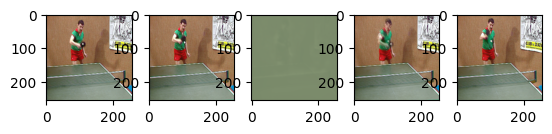

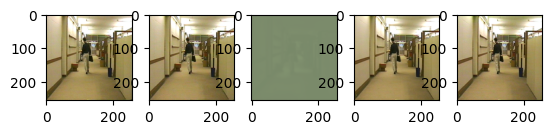

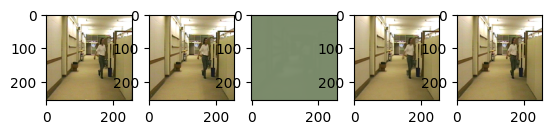

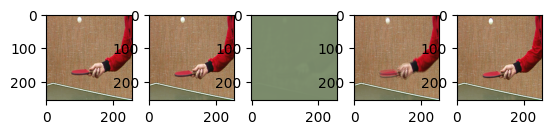

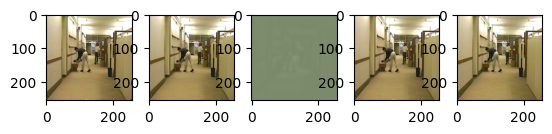

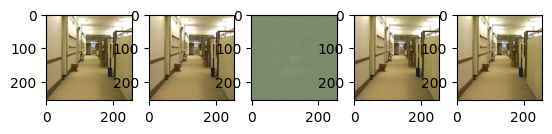

RealLoss= tensor(0.6119, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6954, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5004, 0.5004, 0.5004, 0.5004, 0.5004, 0.5004, 0.5004, 0.5007, 0.5004,
        0.5005, 0.5004, 0.5006, 0.5004, 0.5004, 0.5004, 0.5004, 0.5004, 0.5004,
        0.5004, 0.5004, 0.5004, 0.5004, 0.5004, 0.5004, 0.5006, 0.5004, 0.5004,
        0.5004, 0.5004, 0.5004, 0.5004, 0.5004], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.7026, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6782, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0087, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.6095, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6940, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5002, 0.5002, 0.5002, 0.5002, 0.5005, 0.5002, 0.5002, 0.5002, 0.5003,
        0.5002, 0.5004, 0.5002, 0.

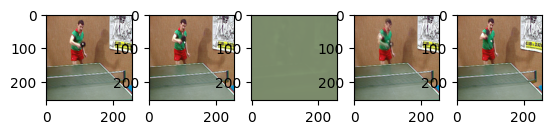

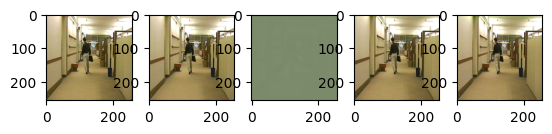

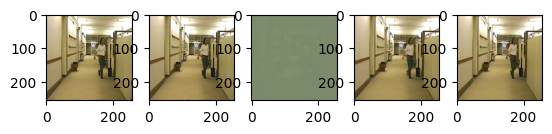

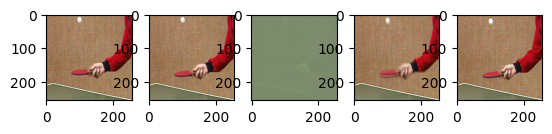

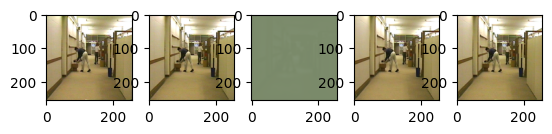

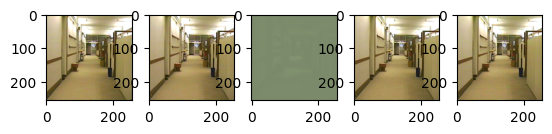

RealLoss= tensor(0.6059, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6931, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5002, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5001, 0.5001, 0.5000, 0.5000, 0.5003], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.7201, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6843, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0087, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.6012, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5002, 0.5002, 0.5003, 0.5003, 0.5003, 0.5002, 0.5003, 0.5003, 0.5002,
        0.5002, 0.5002, 0.5003, 0.

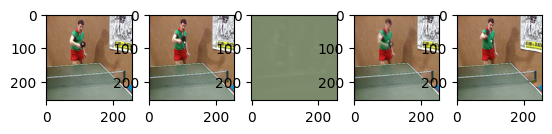

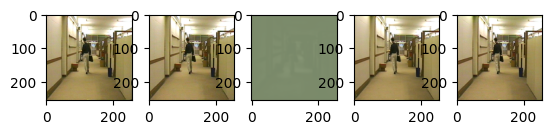

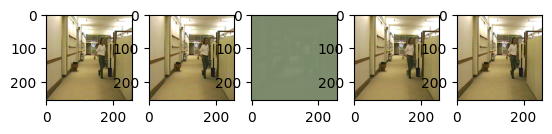

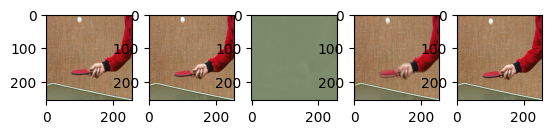

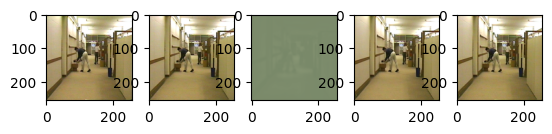

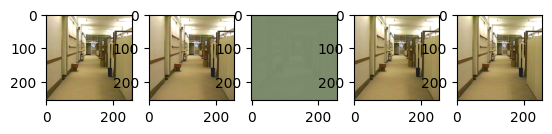

RealLoss= tensor(0.5986, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6938, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5003, 0.5003, 0.5003, 0.5005, 0.5003, 0.5003, 0.5003, 0.5004, 0.5003,
        0.5003, 0.5003, 0.5003, 0.5003, 0.5003, 0.5003, 0.5004, 0.5004, 0.5004,
        0.5003, 0.5003, 0.5003, 0.5003, 0.5003, 0.5004, 0.5003, 0.5003, 0.5004,
        0.5004, 0.5003, 0.5003, 0.5003, 0.5003], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.6896, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6653, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0087, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5965, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6940, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5003, 0.5003, 0.5003, 0.5003, 0.5003, 0.5002, 0.5005, 0.5003, 0.5003,
        0.5004, 0.5003, 0.5003, 0.

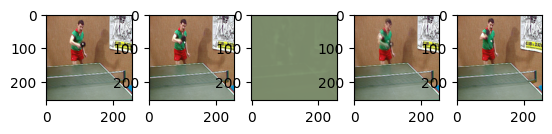

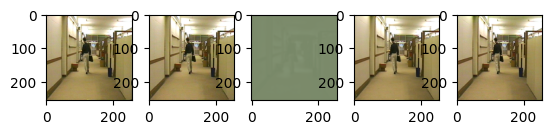

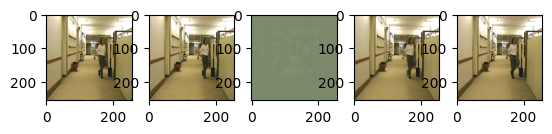

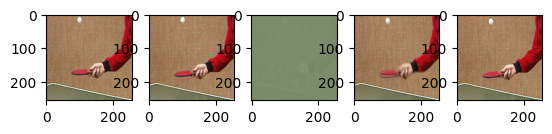

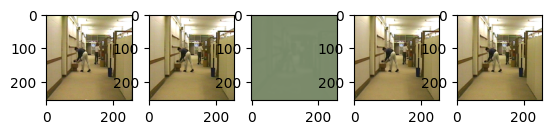

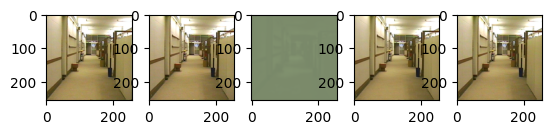

RealLoss= tensor(0.5939, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6936, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001,
        0.5003, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5003,
        0.5002, 0.5001, 0.5002, 0.5001, 0.5001, 0.5001, 0.5002, 0.5002, 0.5003,
        0.5001, 0.5001, 0.5001, 0.5001, 0.5003], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.7047, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6764, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0088, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5909, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6936, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001,
        0.5001, 0.5001, 0.5002, 0.

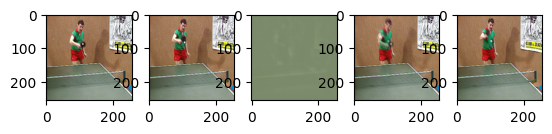

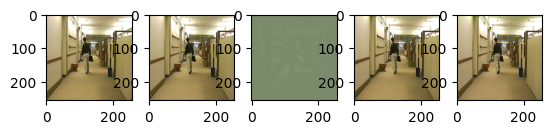

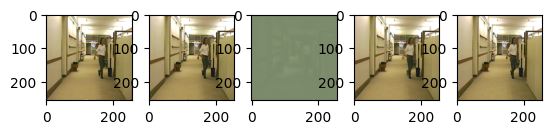

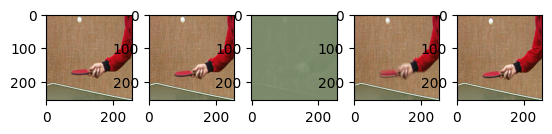

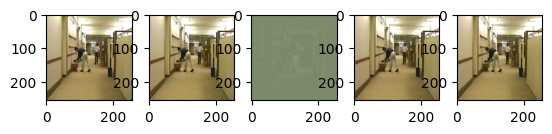

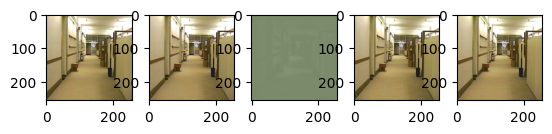

RealLoss= tensor(0.5863, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001,
        0.5000, 0.5003, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5001, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.6999, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6691, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0088, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5850, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5002, 0.5006, 0.5002, 0.5002, 0.5002, 0.5002, 0.5005, 0.5002, 0.5002,
        0.5007, 0.5002, 0.5001, 0.

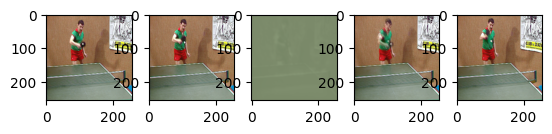

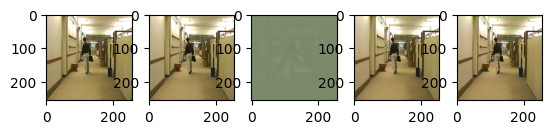

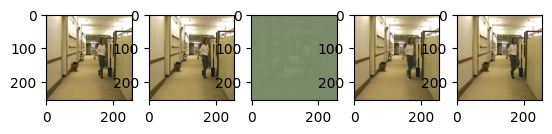

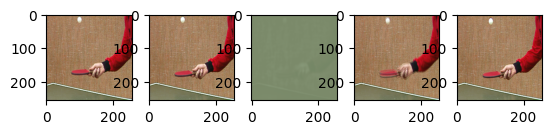

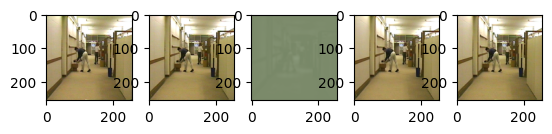

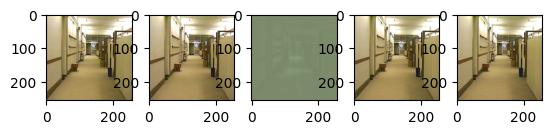

RealLoss= tensor(0.5821, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6937, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5004, 0.5004, 0.5004, 0.5003, 0.5004, 0.5003, 0.5004, 0.5003, 0.5003,
        0.5004, 0.5004, 0.5004, 0.5004, 0.5004, 0.5004, 0.5004, 0.5003, 0.5004,
        0.5003, 0.5003, 0.5004, 0.5004, 0.5004, 0.5004, 0.5004, 0.5004, 0.5004,
        0.5004, 0.5004, 0.5003, 0.5004, 0.5004], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.7090, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6749, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0088, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5821, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6939, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5004, 0.5001, 0.5009, 0.5012, 0.5007, 0.5003, 0.5002, 0.5002, 0.5002,
        0.5002, 0.5002, 0.5002, 0.

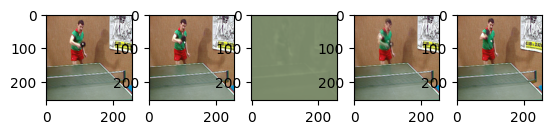

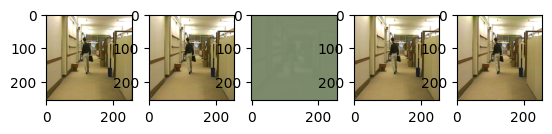

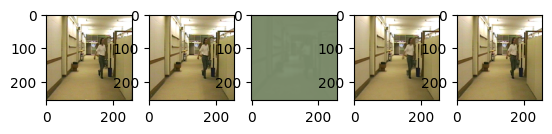

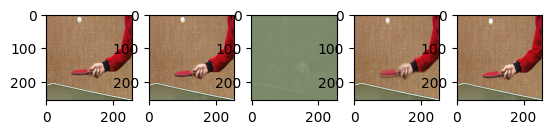

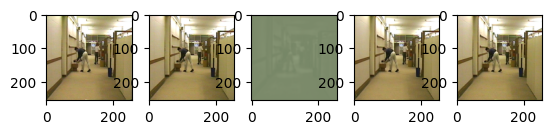

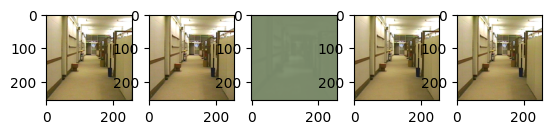

RealLoss= tensor(0.5746, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5002, 0.5001, 0.5001, 0.5002, 0.5001, 0.5001, 0.5002,
        0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5002, 0.5001,
        0.5001, 0.5001, 0.5003, 0.5001, 0.5001, 0.5001, 0.5001, 0.5003, 0.5001,
        0.5001, 0.5001, 0.5002, 0.5001, 0.5004], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.6913, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6626, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0089, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5756, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6936, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5002, 0.5001, 0.5003, 0.5001, 0.5001, 0.5001, 0.5001, 0.5002,
        0.5001, 0.5002, 0.5002, 0.

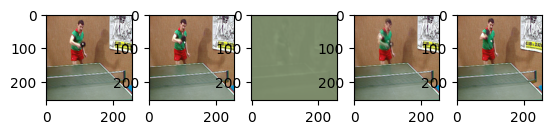

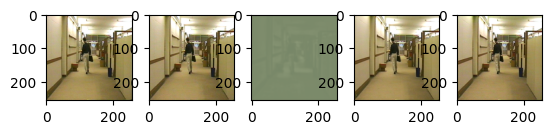

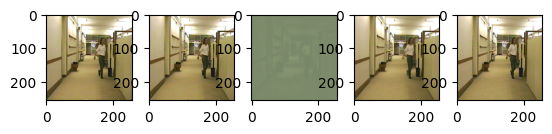

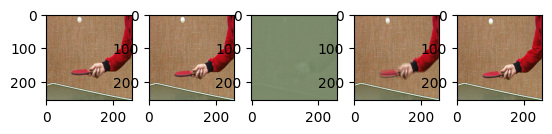

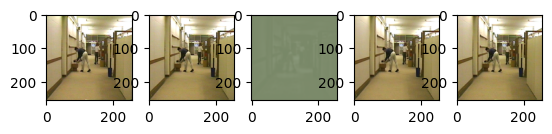

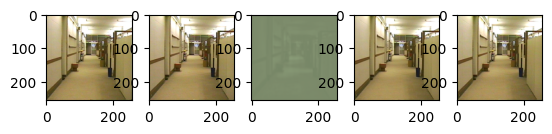

RealLoss= tensor(0.5694, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6937, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002,
        0.5002, 0.5002, 0.5002, 0.5002, 0.5003, 0.5002, 0.5003, 0.5002, 0.5002,
        0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002,
        0.5002, 0.5002, 0.5002, 0.5002, 0.5002], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.6701, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6444, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0090, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5683, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6936, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5000, 0.5001, 0.5001, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000,
        0.5001, 0.5001, 0.5000, 0.

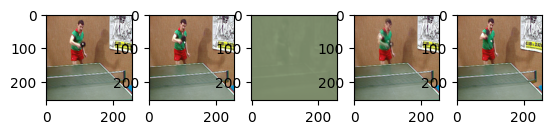

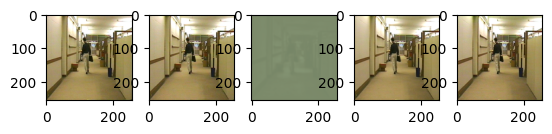

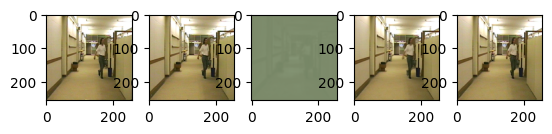

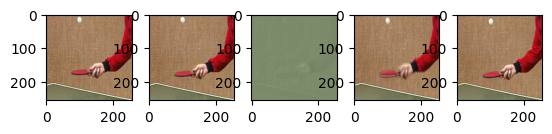

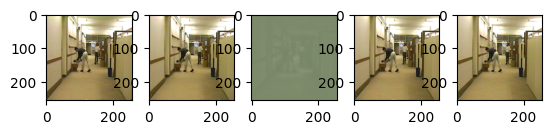

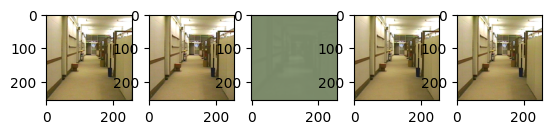

RealLoss= tensor(0.5634, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6935, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5002, 0.5001, 0.5027, 0.5001, 0.5005, 0.5001, 0.5001,
        0.5001, 0.5001, 0.5001, 0.5001, 0.5002, 0.5001, 0.5001, 0.5001, 0.5001,
        0.5001, 0.5002, 0.5001, 0.5007, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001,
        0.5001, 0.5006, 0.5001, 0.5001, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.6894, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6550, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0089, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5650, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6936, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5000, 0.5001, 0.5000, 0.5002, 0.5000, 0.5000, 0.5000, 0.5001,
        0.5000, 0.5001, 0.5001, 0.

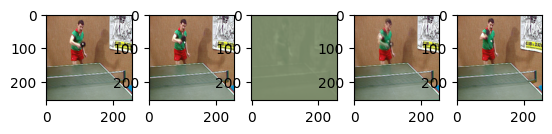

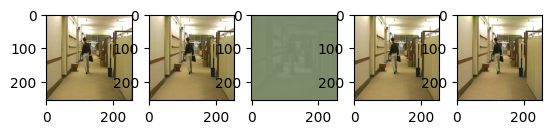

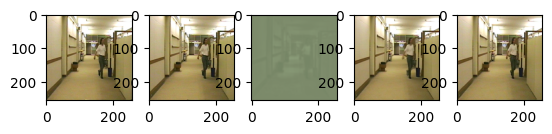

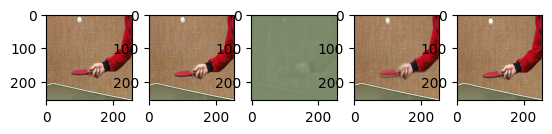

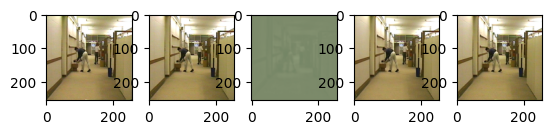

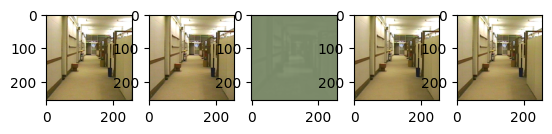

RealLoss= tensor(0.5596, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002,
        0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002,
        0.5002, 0.5002, 0.5003, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002,
        0.5002, 0.5002, 0.5002, 0.5002, 0.5002], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.6447, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6216, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0090, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5560, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6936, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5025, 0.5002, 0.5018, 0.5011, 0.5002, 0.5002, 0.5004, 0.5005, 0.5002,
        0.5002, 0.5002, 0.5002, 0.

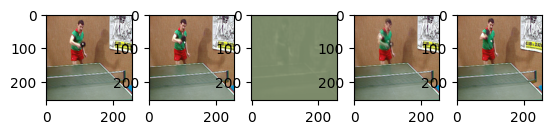

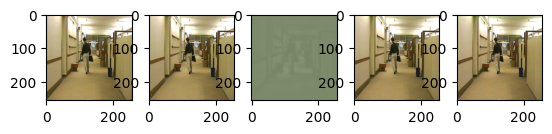

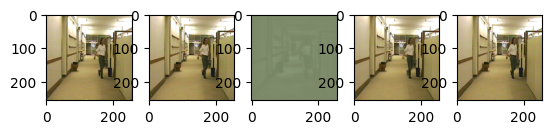

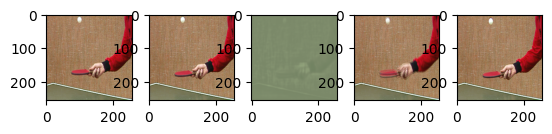

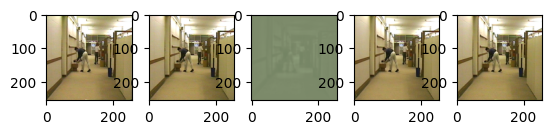

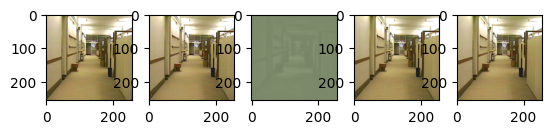

RealLoss= tensor(0.5529, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6939, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5002, 0.5004, 0.5002, 0.5001, 0.5001, 0.5001, 0.5002,
        0.5002, 0.5002, 0.5001, 0.5003, 0.5002, 0.5003, 0.5002, 0.5002, 0.5002,
        0.5001, 0.5001, 0.5002, 0.5001, 0.5003, 0.5001, 0.5002, 0.5002, 0.5002,
        0.5002, 0.5002, 0.5002, 0.5002, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.6413, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6175, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0091, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5534, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6937, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5000, 0.5001, 0.5001, 0.5001, 0.5000, 0.5000, 0.5000, 0.5001,
        0.5001, 0.5002, 0.5001, 0.

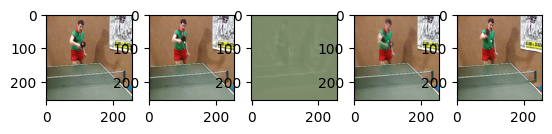

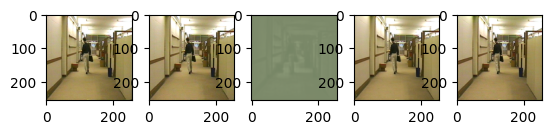

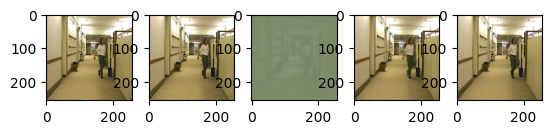

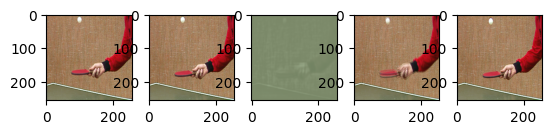

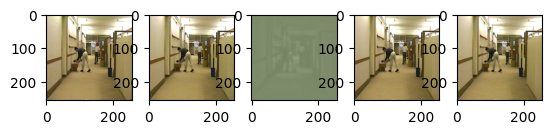

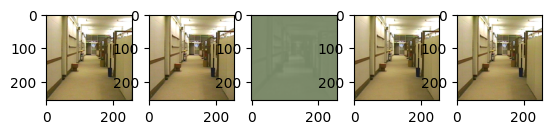

RealLoss= tensor(0.5484, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5002, 0.5000, 0.5000, 0.5005, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001,
        0.5000, 0.5002, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5001, 0.5000,
        0.5000, 0.5003, 0.5000, 0.5000, 0.5003], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.6430, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.6150, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0091, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5487, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5001, 0.5000, 0.5000, 0.5002, 0.5001, 0.5000, 0.5000, 0.5000,
        0.5001, 0.5000, 0.5000, 0.

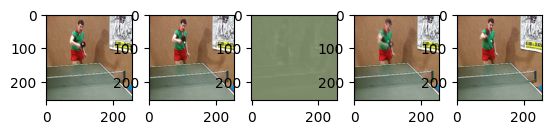

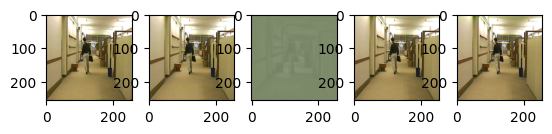

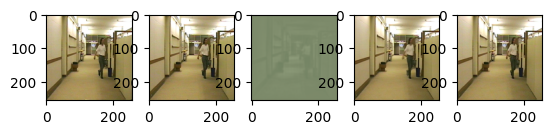

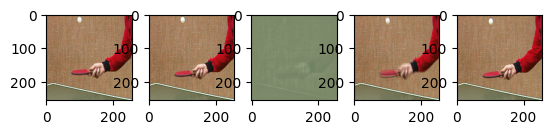

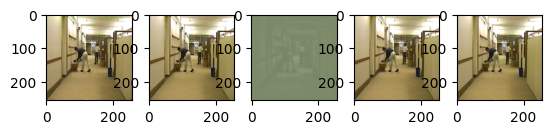

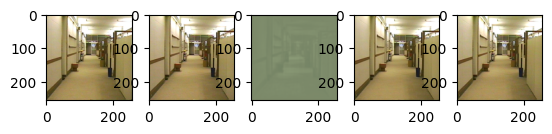

RealLoss= tensor(0.5432, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5002, 0.5002, 0.5002, 0.5001, 0.5003, 0.5002, 0.5002, 0.5001,
        0.5002, 0.5001, 0.5002, 0.5002, 0.5003, 0.5002, 0.5002, 0.5002, 0.5002,
        0.5002, 0.5002, 0.5002, 0.5001, 0.5002, 0.5001, 0.5001, 0.5003, 0.5001,
        0.5002, 0.5002, 0.5002, 0.5002, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.6193, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.5979, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0092, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5407, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6936, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5002, 0.5002, 0.5002, 0.5002, 0.5005, 0.5002, 0.5001, 0.5002, 0.5001,
        0.5002, 0.5001, 0.5001, 0.

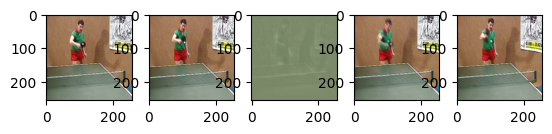

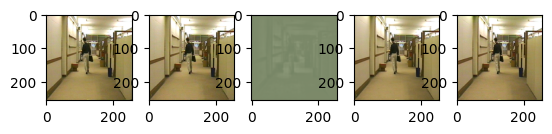

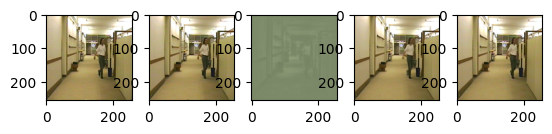

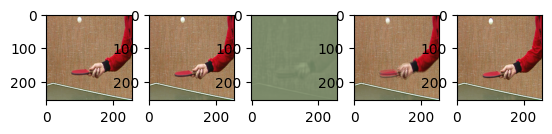

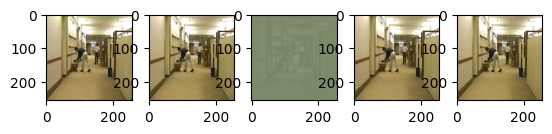

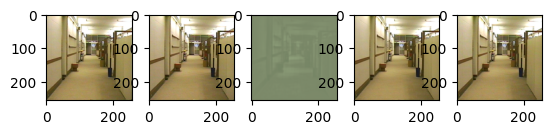

RealLoss= tensor(0.5389, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6936, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5001, 0.5000, 0.5001, 0.5001, 0.5001, 0.5002, 0.5003,
        0.5000, 0.5000, 0.5001, 0.5001, 0.5000, 0.5004, 0.5001, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000,
        0.5001, 0.5000, 0.5000, 0.5000, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.6198, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.5956, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0093, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5366, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5001, 0.

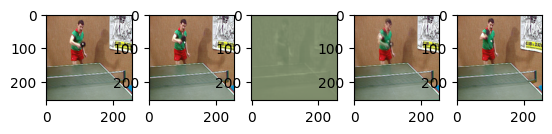

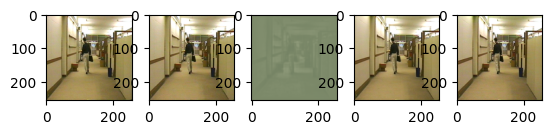

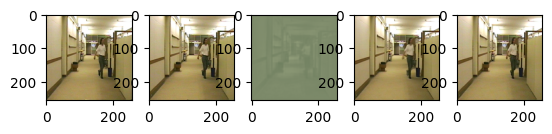

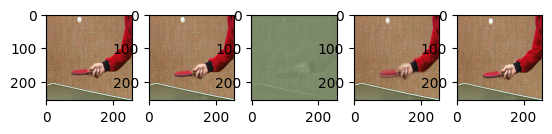

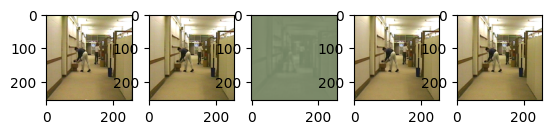

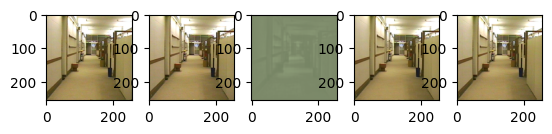

RealLoss= tensor(0.5355, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6936, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5018, 0.5016, 0.5018, 0.5018, 0.5018, 0.5017, 0.5018, 0.5016, 0.5018,
        0.5018, 0.5016, 0.5017, 0.5018, 0.5018, 0.5017, 0.5018, 0.5017, 0.5017,
        0.5018, 0.5018, 0.5018, 0.5018, 0.5018, 0.5021, 0.5021, 0.5018, 0.5018,
        0.5018, 0.5018, 0.5016, 0.5018, 0.5018], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.5720, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.5645, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0093, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5321, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6967, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002, 0.5002,
        0.5002, 0.5003, 0.5002, 0.

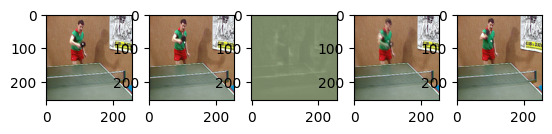

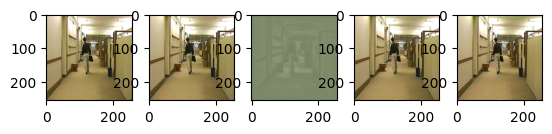

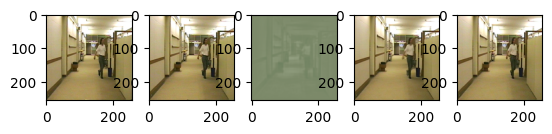

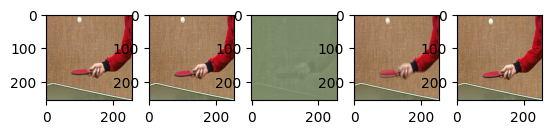

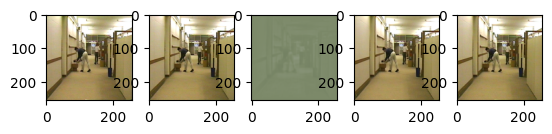

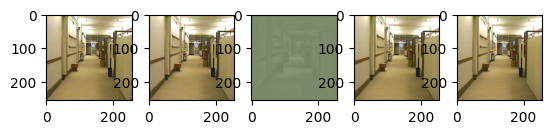

RealLoss= tensor(0.5301, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5002, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5001, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000,
        0.5001, 0.5001, 0.5001, 0.5000, 0.5001, 0.5002, 0.5000, 0.5002, 0.5001,
        0.5000, 0.5000, 0.5001, 0.5004, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.5950, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.5720, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0094, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5263, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6935, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5001, 0.

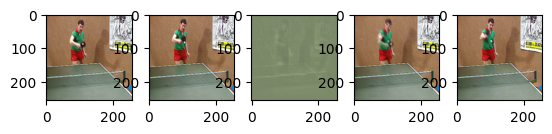

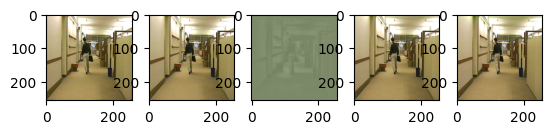

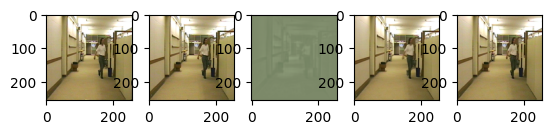

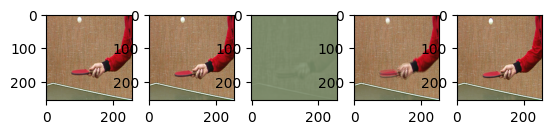

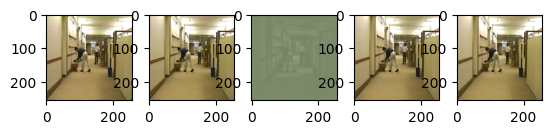

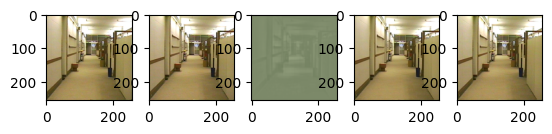

RealLoss= tensor(0.5235, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5001, 0.5008, 0.5001, 0.5001, 0.5001, 0.5002, 0.5009,
        0.5001, 0.5005, 0.5001, 0.5001, 0.5001, 0.5004, 0.5006, 0.5002, 0.5001,
        0.5009, 0.5013, 0.5002, 0.5001, 0.5002, 0.5001, 0.5001, 0.5006, 0.5002,
        0.5001, 0.5001, 0.5004, 0.5006, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.5796, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.5623, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0095, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5223, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6935, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5005, 0.5000, 0.5001, 0.5000, 0.5002, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5001, 0.

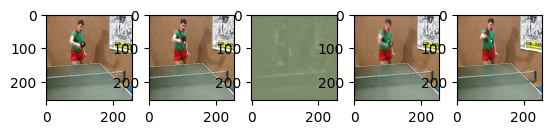

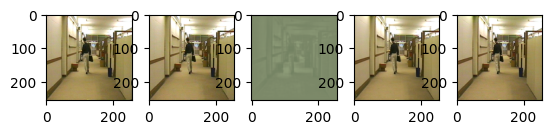

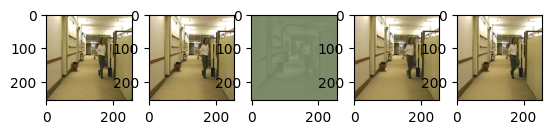

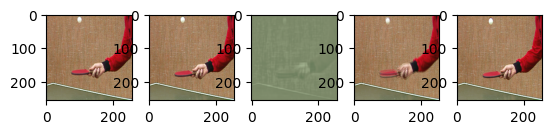

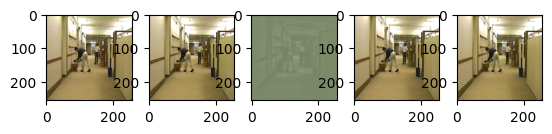

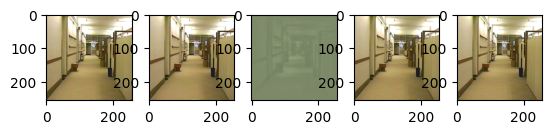

RealLoss= tensor(0.5186, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5002, 0.5002, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001,
        0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5002,
        0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001,
        0.5001, 0.5001, 0.5001, 0.5001, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.5820, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.5615, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0096, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5183, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5007, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000,
        0.5000, 0.5001, 0.5001, 0.

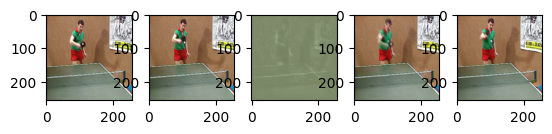

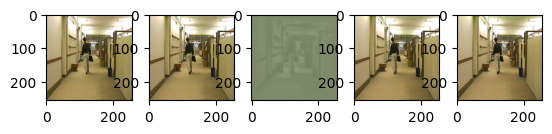

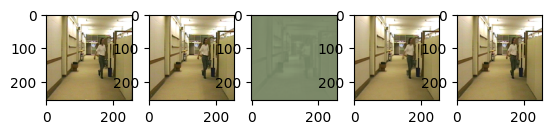

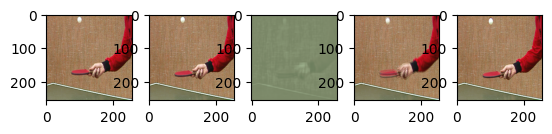

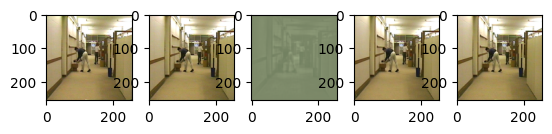

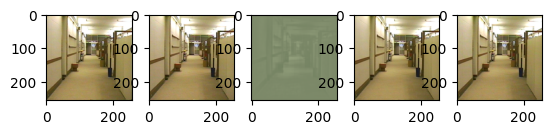

RealLoss= tensor(0.5123, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5003, 0.5000,
        0.5000, 0.5000, 0.5001, 0.5000, 0.5002, 0.5000, 0.5001, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.5942, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.5673, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0096, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5114, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5001, 0.5001, 0.5001, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5001, 0.

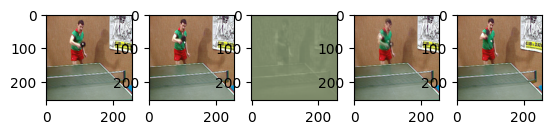

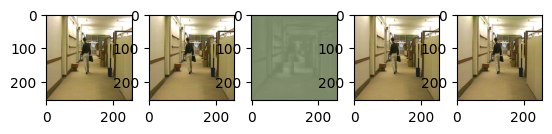

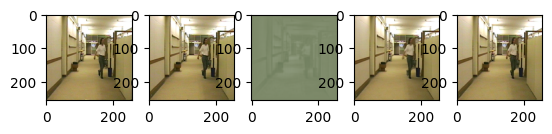

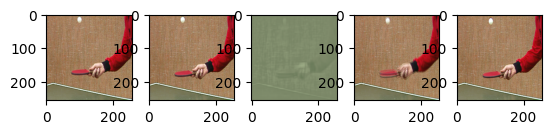

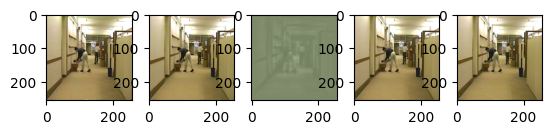

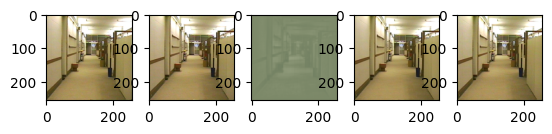

RealLoss= tensor(0.5071, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.5940, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.5643, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0096, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5078, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5002, 0.5000, 0.5000, 0.5001,
        0.5006, 0.5000, 0.5000, 0.

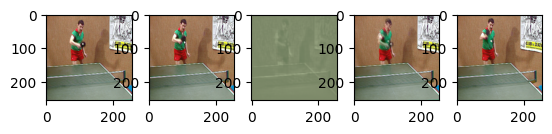

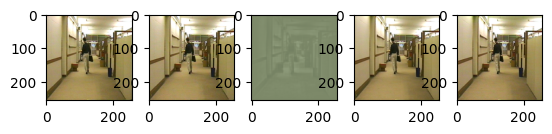

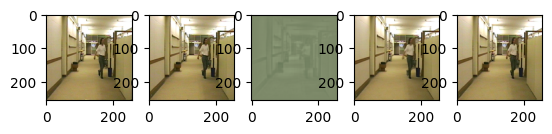

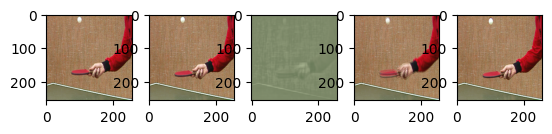

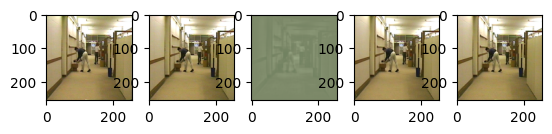

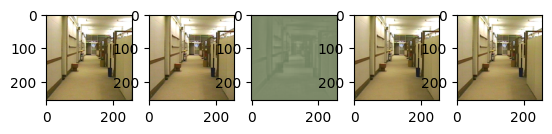

RealLoss= tensor(0.5044, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6935, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5002, 0.5001, 0.5000, 0.5001,
        0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5002, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5003,
        0.5007, 0.5000, 0.5002, 0.5001, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.5701, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.5466, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0097, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.5043, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001,
        0.5000, 0.5000, 0.5000, 0.

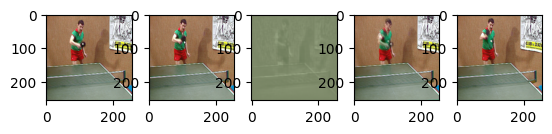

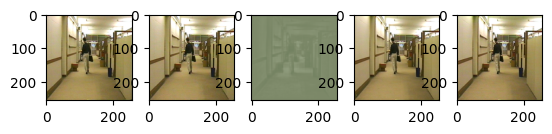

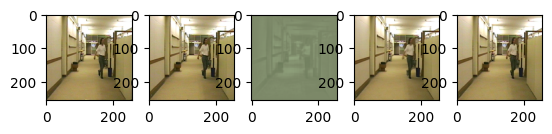

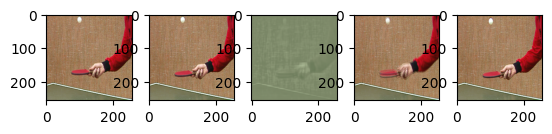

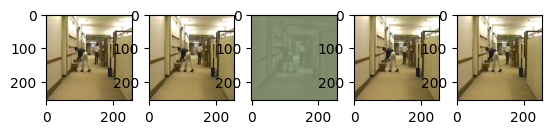

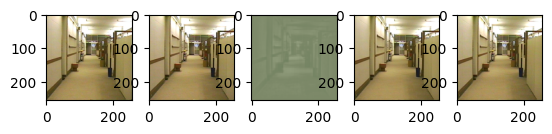

RealLoss= tensor(0.4977, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6936, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5000, 0.5001, 0.5001, 0.5000, 0.5001, 0.5000, 0.5000, 0.5004,
        0.5001, 0.5001, 0.5000, 0.5001, 0.5002, 0.5001, 0.5001, 0.5000, 0.5001,
        0.5001, 0.5001, 0.5001, 0.5001, 0.5000, 0.5000, 0.5001, 0.5003, 0.5001,
        0.5000, 0.5001, 0.5001, 0.5001, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.5181, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.5092, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0098, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4968, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5002, 0.5000, 0.5000, 0.5001,
        0.5000, 0.5000, 0.5000, 0.

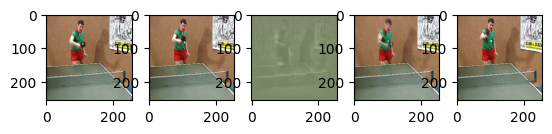

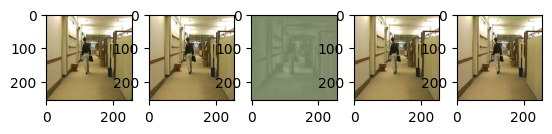

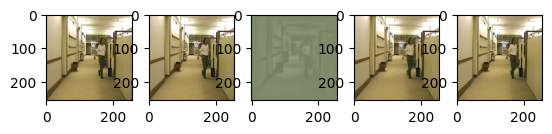

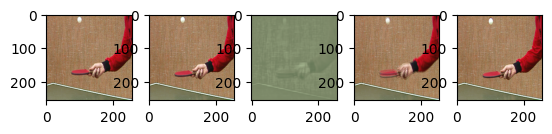

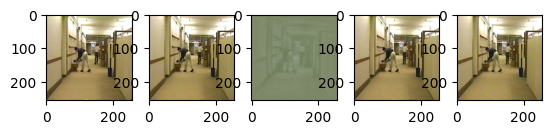

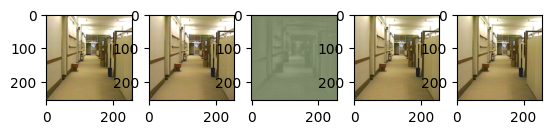

RealLoss= tensor(0.4939, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6940, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5003, 0.5000, 0.5000, 0.5000, 0.5000, 0.5005,
        0.5000, 0.5001, 0.5000, 0.5000, 0.5019, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5001, 0.5000, 0.5004, 0.5000, 0.5000, 0.5000, 0.5002, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5008, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.5328, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.5170, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0098, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4922, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001,
        0.5000, 0.5000, 0.5000, 0.

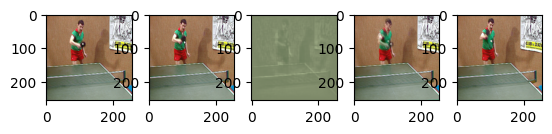

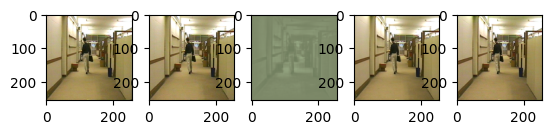

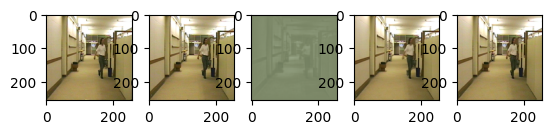

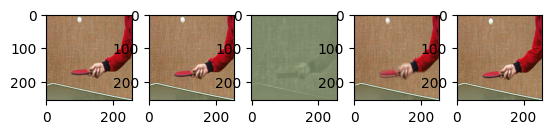

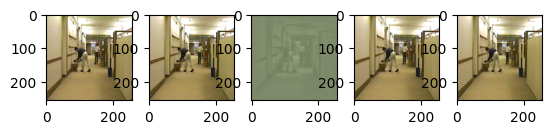

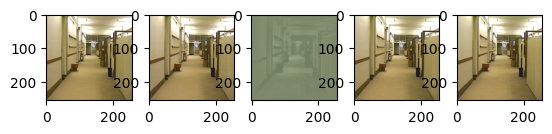

RealLoss= tensor(0.4900, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5025, 0.5000, 0.5001, 0.5001, 0.5000, 0.5004, 0.5000, 0.5002, 0.5000,
        0.5004, 0.5000, 0.5004, 0.5001, 0.5000, 0.5015, 0.5000, 0.5007, 0.5000,
        0.5000, 0.5000, 0.5002, 0.5001, 0.5000, 0.5000, 0.5003, 0.5003, 0.5000,
        0.5001, 0.5000, 0.5000, 0.5002, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.5066, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.4961, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0099, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4873, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5001, 0.5001, 0.5001, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5001, 0.5000, 0.5000, 0.

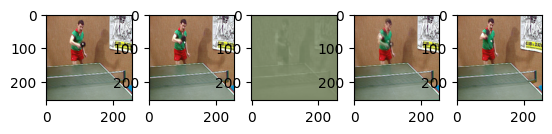

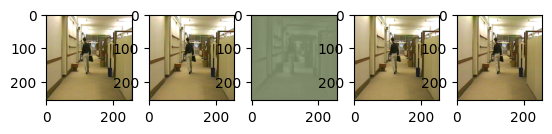

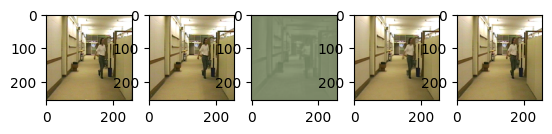

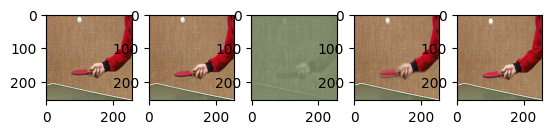

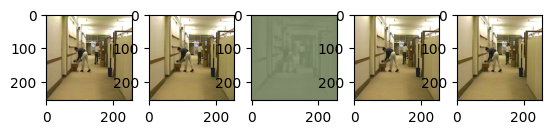

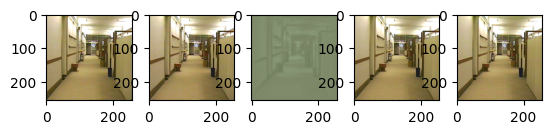

RealLoss= tensor(0.4856, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5003,
        0.5001, 0.5004, 0.5001, 0.5001, 0.5002, 0.5001, 0.5001, 0.5001, 0.5002,
        0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001,
        0.5001, 0.5001, 0.5001, 0.5001, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.5021, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.4925, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0099, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4841, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6936, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5005, 0.5000, 0.5000, 0.5002, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.

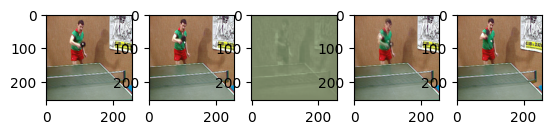

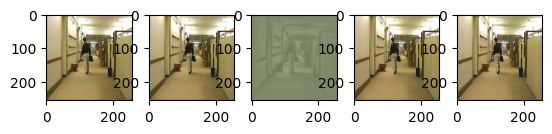

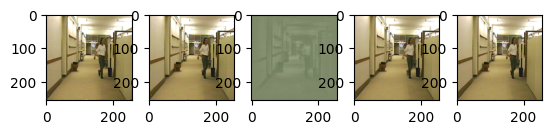

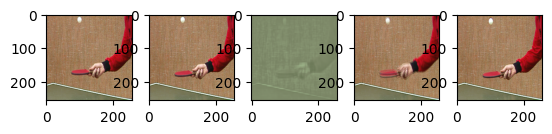

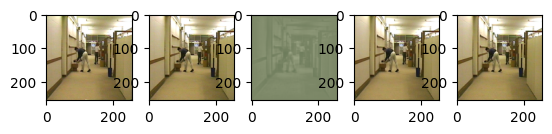

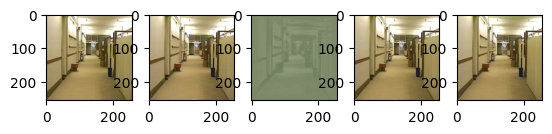

RealLoss= tensor(0.4820, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5003, 0.5001, 0.5000, 0.5004, 0.5000, 0.5000, 0.5001, 0.5001,
        0.5001, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5002,
        0.5002, 0.5000, 0.5001, 0.5000, 0.5001, 0.5000, 0.5001, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5001, 0.5002], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.4578, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.4607, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0100, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4802, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5001, 0.5008, 0.5001, 0.5022, 0.5001, 0.5001, 0.5001,
        0.5001, 0.5001, 0.5001, 0.

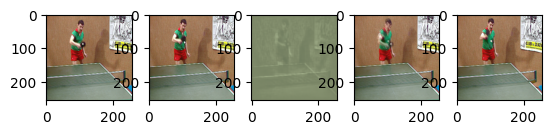

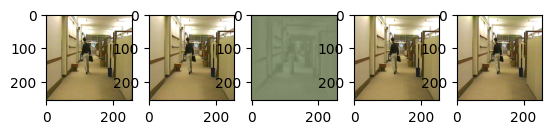

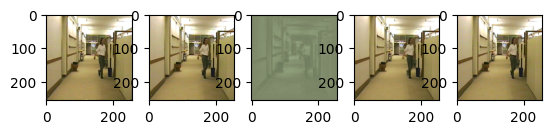

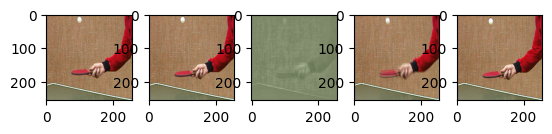

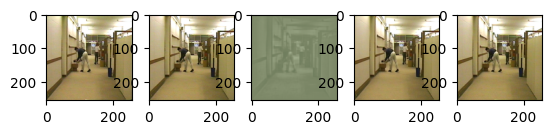

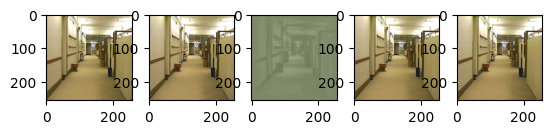

RealLoss= tensor(0.4748, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5003, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.4920, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.4798, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0101, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4736, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5004, 0.5004, 0.5004, 0.5011, 0.5003, 0.5004, 0.5004, 0.5003, 0.5004,
        0.5005, 0.5004, 0.5004, 0.

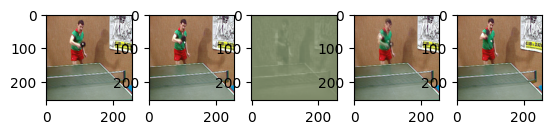

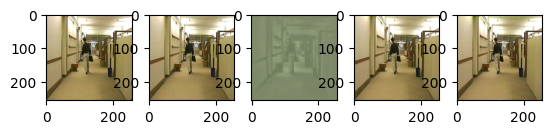

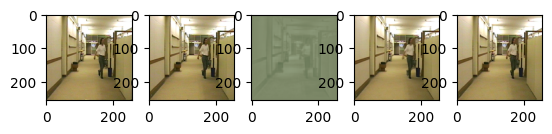

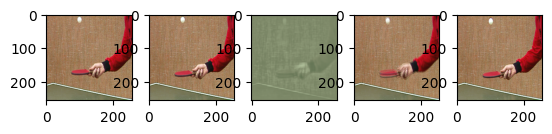

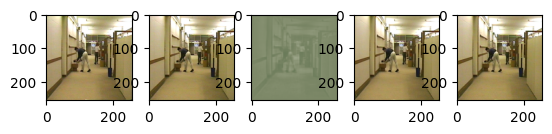

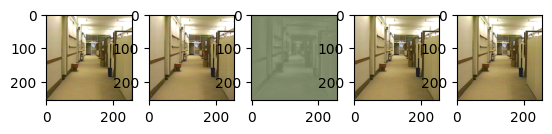

RealLoss= tensor(0.4710, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6938, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5002, 0.5002, 0.5001, 0.5002, 0.5001, 0.5001, 0.5003, 0.5001, 0.5001,
        0.5010, 0.5001, 0.5008, 0.5001, 0.5002, 0.5008, 0.5001, 0.5001, 0.5001,
        0.5002, 0.5011, 0.5003, 0.5001, 0.5001, 0.5002, 0.5002, 0.5002, 0.5001,
        0.5001, 0.5001, 0.5001, 0.5001, 0.5002], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.4637, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.4593, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0102, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4696, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6935, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5001, 0.5006, 0.5000, 0.5001, 0.5001, 0.5001, 0.5001, 0.5006,
        0.5001, 0.5000, 0.5001, 0.

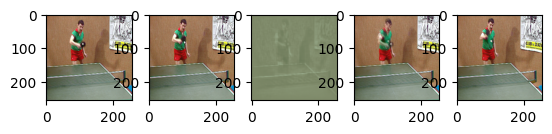

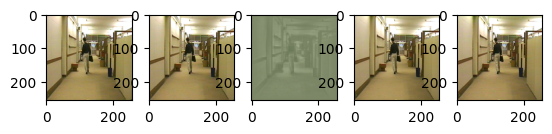

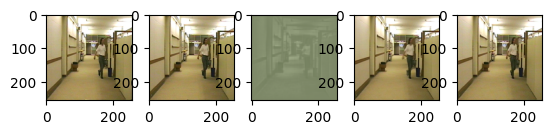

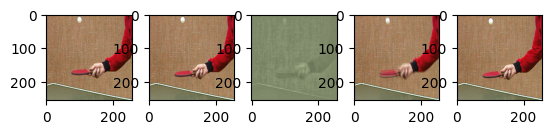

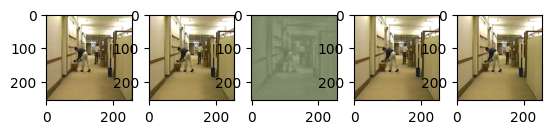

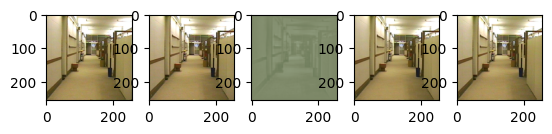

RealLoss= tensor(0.4681, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5000, 0.5000, 0.5012, 0.5001, 0.5000, 0.5001, 0.5001, 0.5000,
        0.5001, 0.5002, 0.5000, 0.5001, 0.5001, 0.5001, 0.5006, 0.5002, 0.5000,
        0.5000, 0.5011, 0.5000, 0.5001, 0.5003, 0.5000, 0.5002, 0.5006, 0.5001,
        0.5001, 0.5001, 0.5000, 0.5001, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.4373, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.4385, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0105, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4648, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5002, 0.5000, 0.5000, 0.5006,
        0.5001, 0.5000, 0.5001, 0.

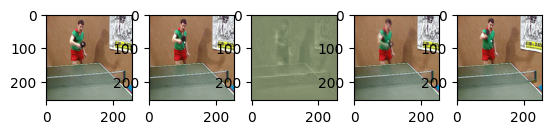

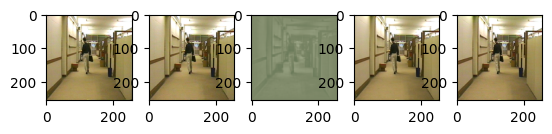

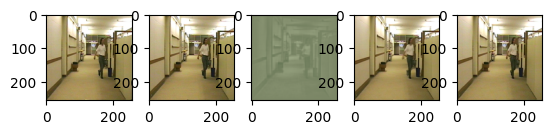

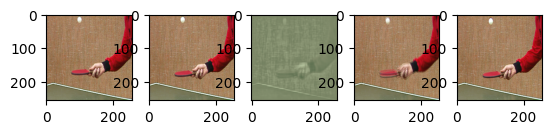

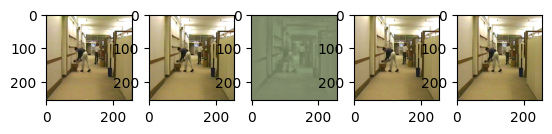

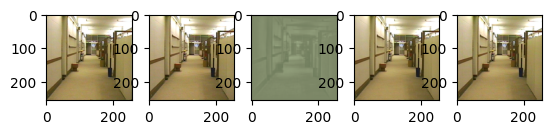

RealLoss= tensor(0.4618, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5007, 0.5001, 0.5003, 0.5001, 0.5001, 0.5001, 0.5000, 0.5000,
        0.5001, 0.5000, 0.5000, 0.5002, 0.5001, 0.5000, 0.5001, 0.5001, 0.5001,
        0.5001, 0.5001, 0.5000, 0.5001, 0.5004, 0.5001, 0.5002, 0.5001, 0.5001,
        0.5001, 0.5002, 0.5001, 0.5001, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.4663, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.4544, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0104, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4610, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6935, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5002, 0.5006, 0.5001, 0.5001, 0.5000, 0.5000, 0.5002, 0.5001, 0.5001,
        0.5000, 0.5001, 0.5001, 0.

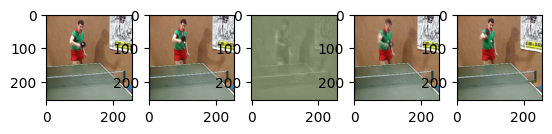

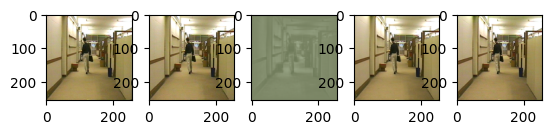

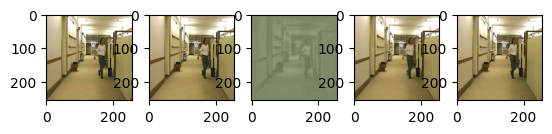

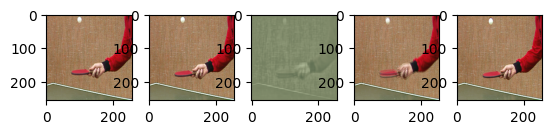

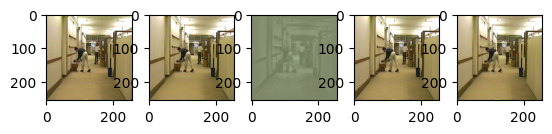

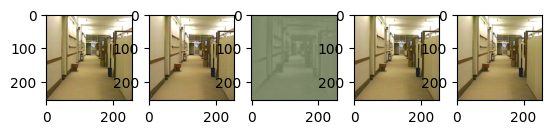

RealLoss= tensor(0.4570, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5002, 0.5002, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5002,
        0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5001, 0.5001,
        0.5000, 0.5000, 0.5000, 0.5002, 0.5002, 0.5000, 0.5000, 0.5000, 0.5004,
        0.5001, 0.5000, 0.5000, 0.5000, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.4278, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.4279, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0106, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4564, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5002, 0.5000, 0.5000, 0.5000, 0.5007, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.

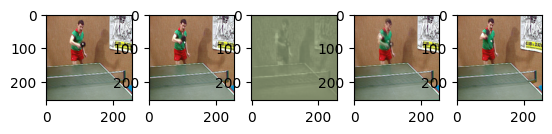

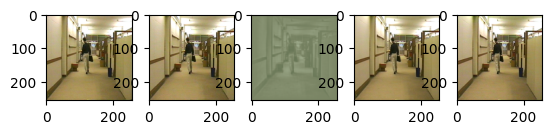

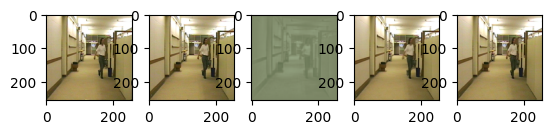

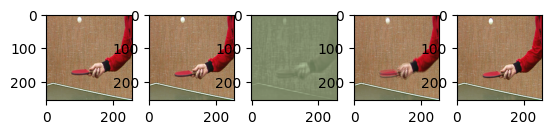

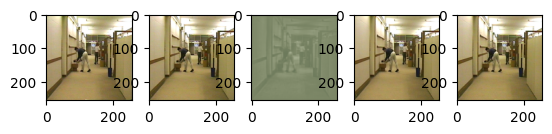

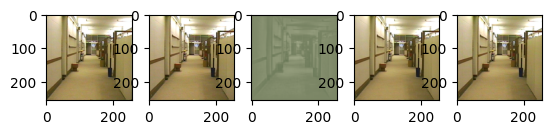

RealLoss= tensor(0.4530, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6935, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5002, 0.5000, 0.5002, 0.5001, 0.5002, 0.5000, 0.5000, 0.5000, 0.5006,
        0.5000, 0.5000, 0.5000, 0.5001, 0.5002, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5003, 0.5016, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5003, 0.5001, 0.5000, 0.5002, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.4307, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.4293, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0105, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4528, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6935, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5001, 0.5000,
        0.5000, 0.5000, 0.5000, 0.

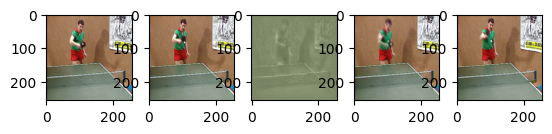

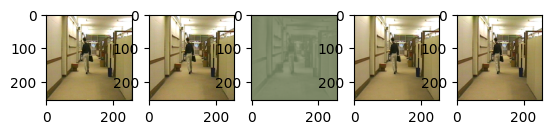

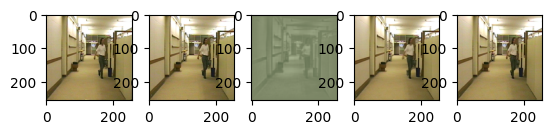

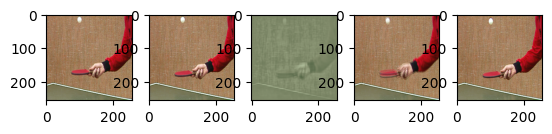

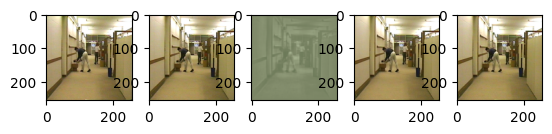

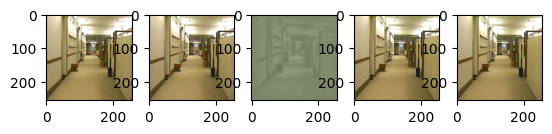

RealLoss= tensor(0.4488, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5001, 0.5013, 0.5014, 0.5002, 0.5001, 0.5003, 0.5001,
        0.5001, 0.5001, 0.5001, 0.5001, 0.5002, 0.5006, 0.5001, 0.5001, 0.5001,
        0.5001, 0.5001, 0.5000, 0.5003, 0.5001, 0.5001, 0.5001, 0.5003, 0.5001,
        0.5000, 0.5001, 0.5003, 0.5002, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.4112, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.4120, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0107, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4482, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6935, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5001, 0.5001, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000,
        0.5000, 0.5000, 0.5000, 0.

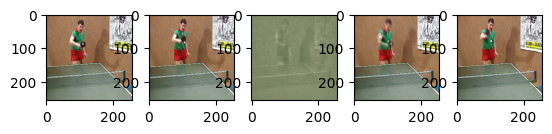

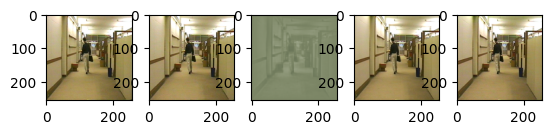

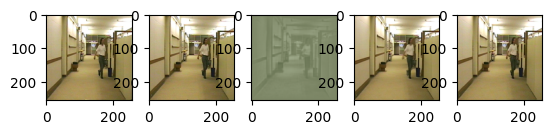

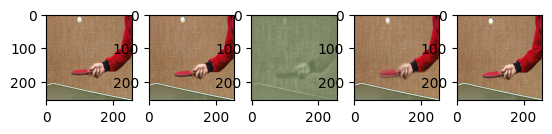

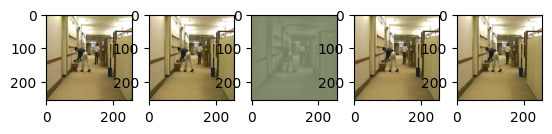

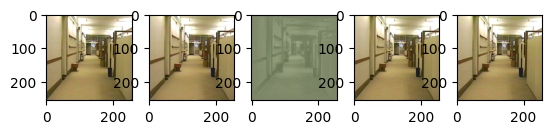

RealLoss= tensor(0.4461, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5001, 0.5002, 0.5001, 0.5000, 0.5000, 0.5000, 0.5001,
        0.5000, 0.5001, 0.5001, 0.5002, 0.5001, 0.5001, 0.5001, 0.5001, 0.5000,
        0.5001, 0.5000, 0.5005, 0.5000, 0.5000, 0.5001, 0.5000, 0.5001, 0.5005,
        0.5000, 0.5002, 0.5002, 0.5001, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.4151, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.4141, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0109, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4433, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5002, 0.5000, 0.5006, 0.5000, 0.5001, 0.5001, 0.5000,
        0.5001, 0.5000, 0.5001, 0.

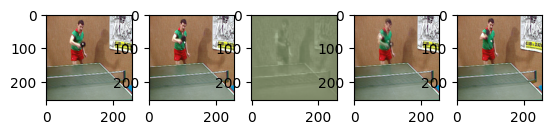

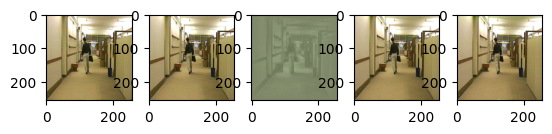

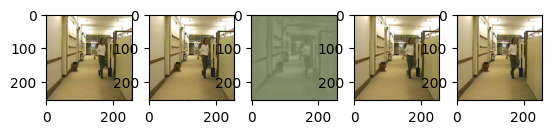

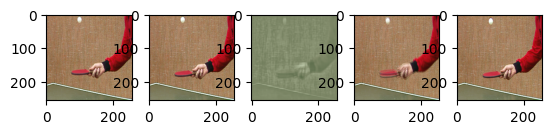

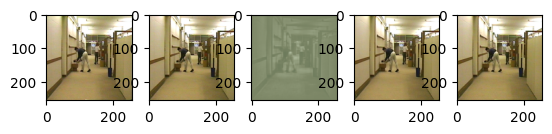

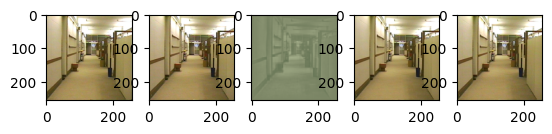

RealLoss= tensor(0.4408, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6938, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5022, 0.5000, 0.5001, 0.5001, 0.5002, 0.5000, 0.5000, 0.5002,
        0.5000, 0.5000, 0.5001, 0.5001, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5001, 0.5001, 0.5000, 0.5001, 0.5000, 0.5001, 0.5000, 0.5000, 0.5001,
        0.5017, 0.5011, 0.5000, 0.5000, 0.5003], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.4007, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3994, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0109, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4399, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6935, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5003, 0.5000,
        0.5000, 0.5014, 0.5000, 0.

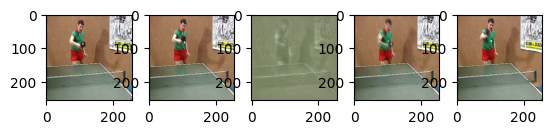

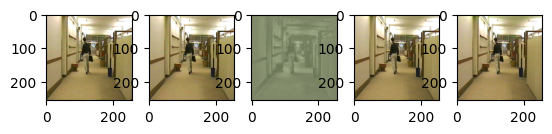

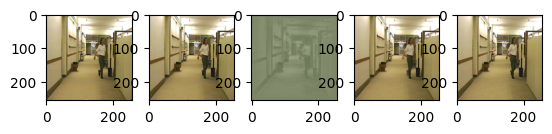

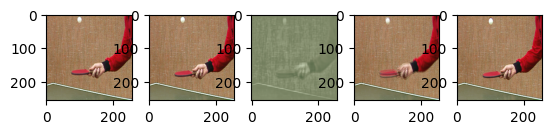

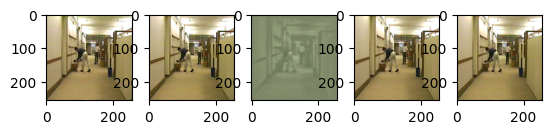

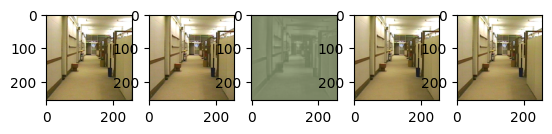

RealLoss= tensor(0.4361, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5003, 0.5001, 0.5001, 0.5000, 0.5000, 0.5000, 0.5002, 0.5001, 0.5007,
        0.5004, 0.5000, 0.5000, 0.5002, 0.5004, 0.5001, 0.5001, 0.5000, 0.5000,
        0.5000, 0.5001, 0.5001, 0.5000, 0.5001, 0.5000, 0.5002, 0.5000, 0.5002,
        0.5000, 0.5001, 0.5001, 0.5000, 0.5009], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.3876, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3921, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0111, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4352, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6935, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5000, 0.5001, 0.5001, 0.5001, 0.5001, 0.5001, 0.5002,
        0.5001, 0.5001, 0.5001, 0.

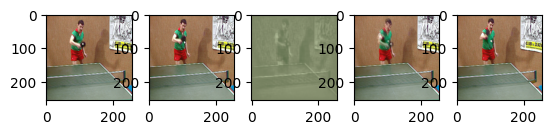

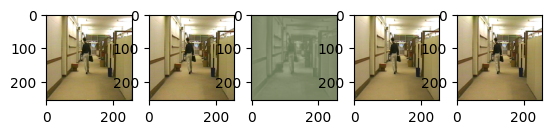

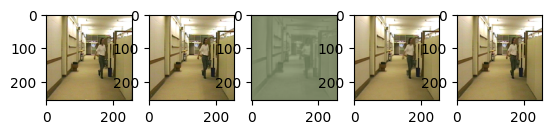

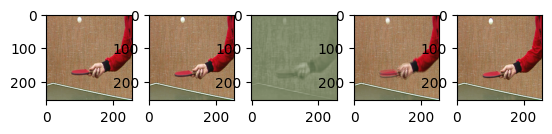

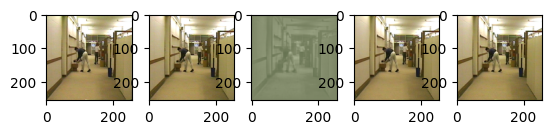

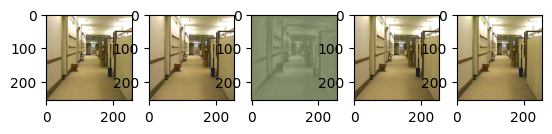

RealLoss= tensor(0.4316, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5005, 0.5001, 0.5002, 0.5001, 0.5000, 0.5001, 0.5001, 0.5000, 0.5001,
        0.5000, 0.5002, 0.5000, 0.5002, 0.5000, 0.5001, 0.5001, 0.5000, 0.5001,
        0.5000, 0.5030, 0.5001, 0.5000, 0.5005, 0.5000, 0.5001, 0.5000, 0.5001,
        0.5010, 0.5001, 0.5002, 0.5002, 0.5002], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.3650, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3767, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0112, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4310, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6935, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5002, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5007,
        0.5000, 0.5000, 0.5014, 0.

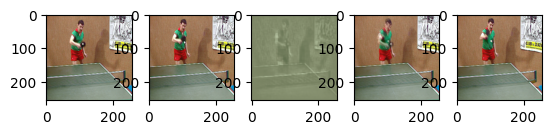

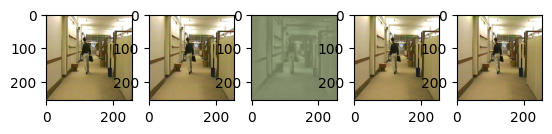

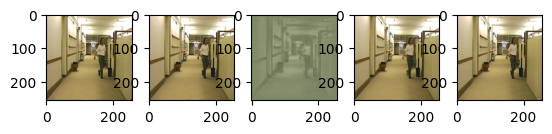

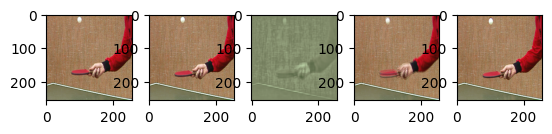

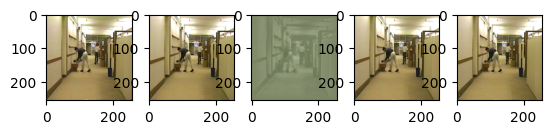

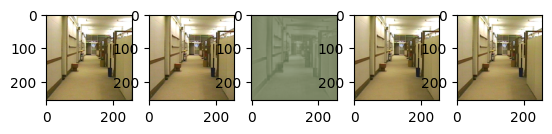

RealLoss= tensor(0.4270, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5009, 0.5003, 0.5003, 0.5002, 0.5003, 0.5001, 0.5002, 0.5003, 0.5003,
        0.5002, 0.5002, 0.5002, 0.5007, 0.5005, 0.5003, 0.5002, 0.5003, 0.5007,
        0.5002, 0.5003, 0.5003, 0.5002, 0.5003, 0.5003, 0.5003, 0.5002, 0.5003,
        0.5002, 0.5003, 0.5012, 0.5001, 0.5002], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.3676, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3737, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0113, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4258, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6938, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5002, 0.5012, 0.5001, 0.5002, 0.5002, 0.5002, 0.5001, 0.5002,
        0.5002, 0.5002, 0.5001, 0.

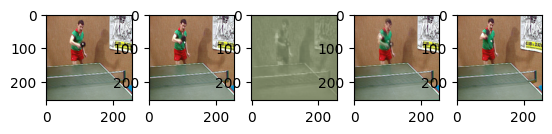

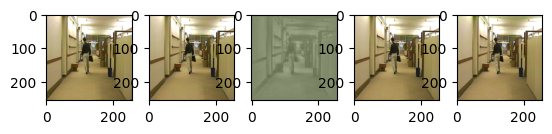

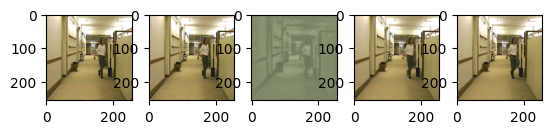

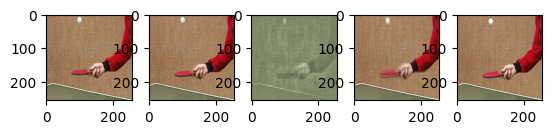

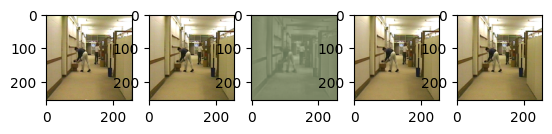

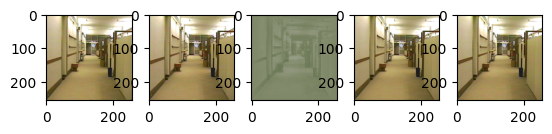

RealLoss= tensor(0.4240, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6937, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5001, 0.5006,
        0.5002, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000,
        0.5001, 0.5001, 0.5001, 0.5001, 0.5002, 0.5000, 0.5002, 0.5001, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.3612, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3712, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0114, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4223, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5002, 0.5000, 0.5000, 0.5001, 0.5000, 0.5002, 0.5000,
        0.5000, 0.5000, 0.5000, 0.

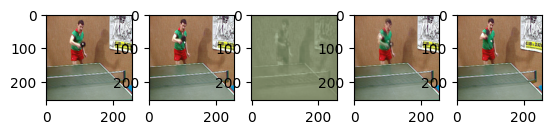

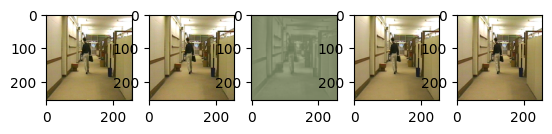

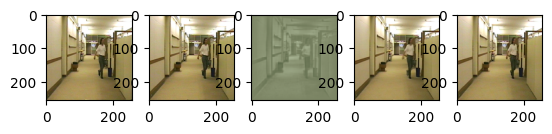

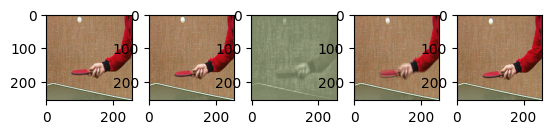

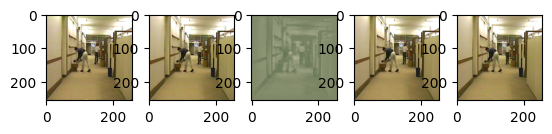

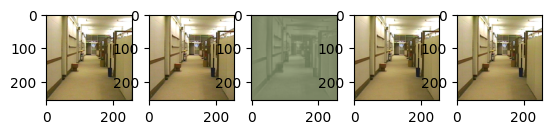

RealLoss= tensor(0.4192, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5002, 0.5000,
        0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5005, 0.5000,
        0.5000, 0.5000, 0.5003, 0.5001, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.3636, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3651, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0115, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4187, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5001, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5002, 0.

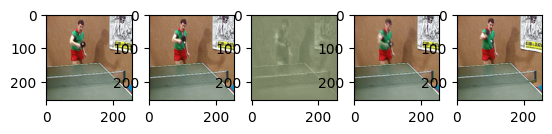

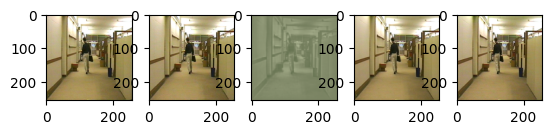

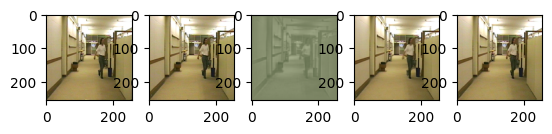

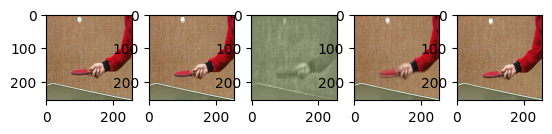

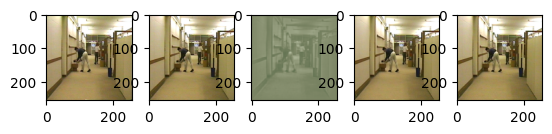

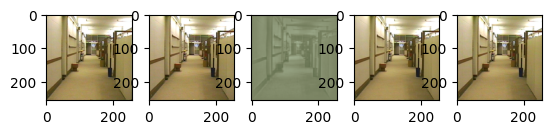

RealLoss= tensor(0.4158, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5001, 0.5000, 0.5000, 0.5003, 0.5000, 0.5001, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5001, 0.5000, 0.5000, 0.5003, 0.5000, 0.5001, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.3503, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3581, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0116, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4143, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5004, 0.5000, 0.5000,
        0.5001, 0.5001, 0.5001, 0.

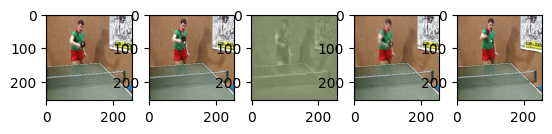

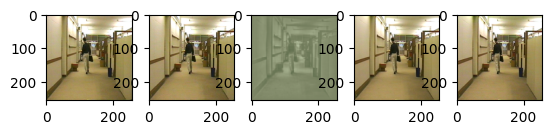

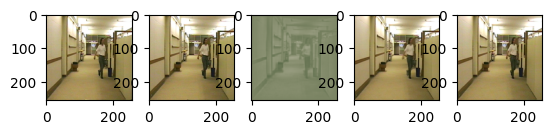

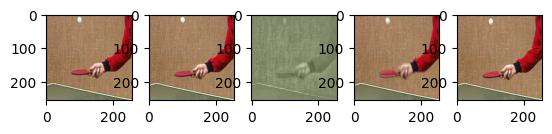

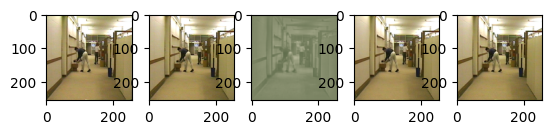

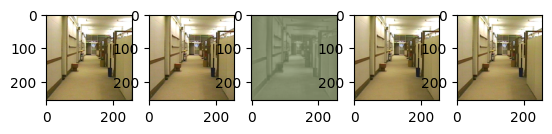

RealLoss= tensor(0.4150, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6934, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5002, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5004, 0.5000, 0.5000, 0.5000, 0.5001, 0.5001, 0.5000, 0.5000,
        0.5003, 0.5000, 0.5000, 0.5001, 0.5000, 0.5007, 0.5002, 0.5001, 0.5000,
        0.5001, 0.5000, 0.5001, 0.5000, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.3128, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3270, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0121, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4118, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5006, 0.

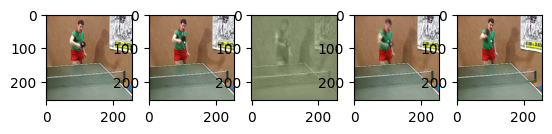

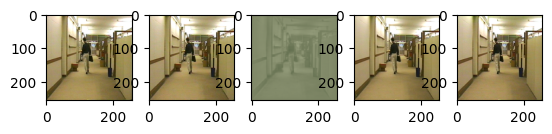

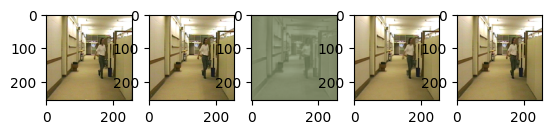

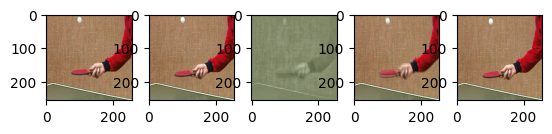

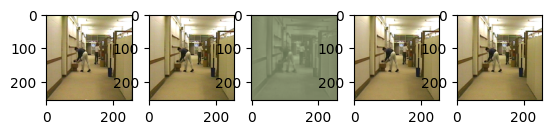

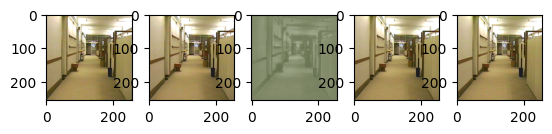

RealLoss= tensor(0.4084, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6937, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5024,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.3346, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3463, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0118, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4070, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.

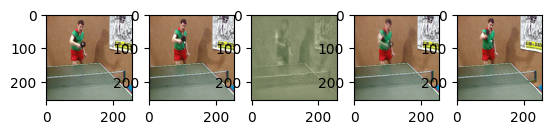

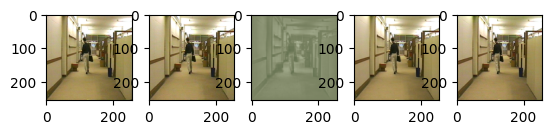

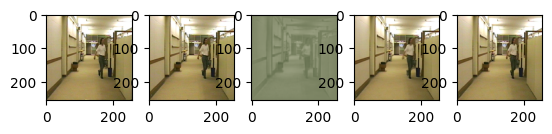

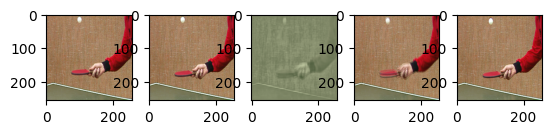

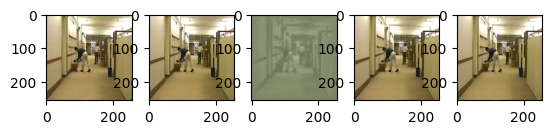

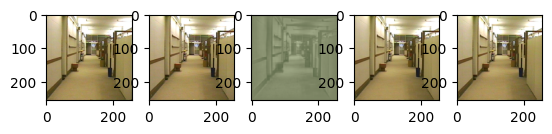

RealLoss= tensor(0.4034, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6944, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5002, 0.5000, 0.5003, 0.5000,
        0.5000, 0.5000, 0.5033, 0.5000, 0.5000, 0.5001, 0.5003, 0.5002, 0.5001,
        0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001,
        0.5001, 0.5001, 0.5000, 0.5000, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.3324, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3383, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0121, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.4025, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6937, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5008, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5002, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.

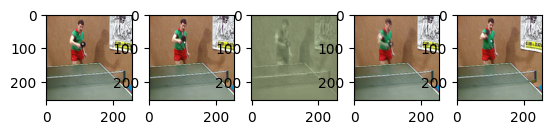

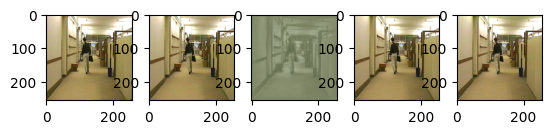

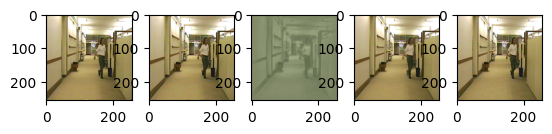

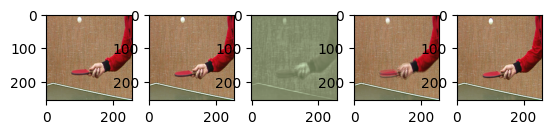

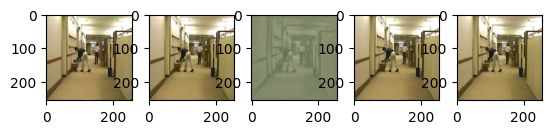

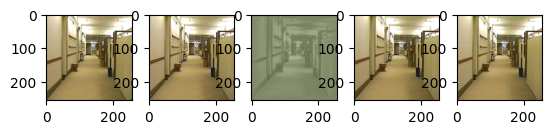

RealLoss= tensor(0.4003, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6935, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5000, 0.5002, 0.5000, 0.5007, 0.5001, 0.5002, 0.5000,
        0.5000, 0.5002, 0.5000, 0.5001, 0.5000, 0.5001, 0.5000, 0.5000, 0.5001,
        0.5002, 0.5002, 0.5000, 0.5001, 0.5001, 0.5005, 0.5005, 0.5000, 0.5001,
        0.5002, 0.5001, 0.5001, 0.5001, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.3058, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3208, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0125, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.3978, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6937, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5001,
        0.5002, 0.5001, 0.5000, 0.

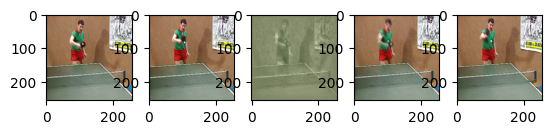

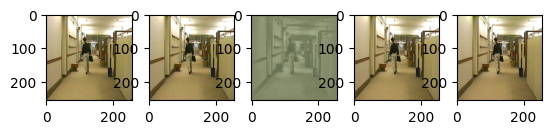

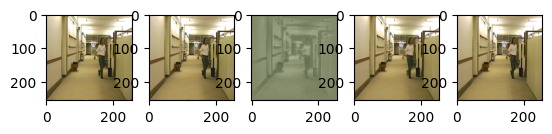

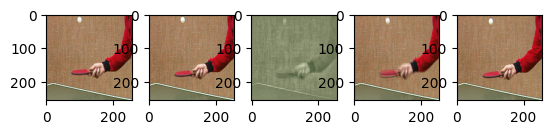

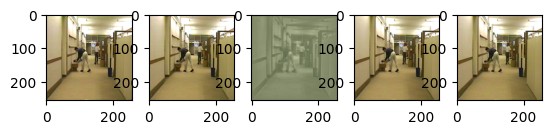

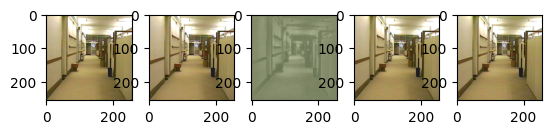

RealLoss= tensor(0.3951, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5001, 0.5001, 0.5000, 0.5000, 0.5001, 0.5001, 0.5001,
        0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5001, 0.5000,
        0.5000, 0.5000, 0.5001, 0.5001, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000,
        0.5000, 0.5001, 0.5000, 0.5000, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.3061, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3141, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0124, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.3938, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5002, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5002,
        0.5001, 0.5001, 0.5002, 0.

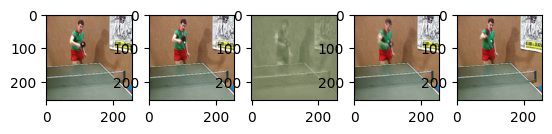

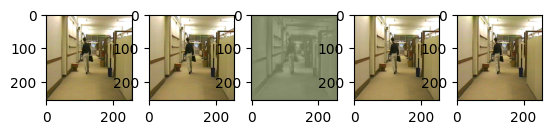

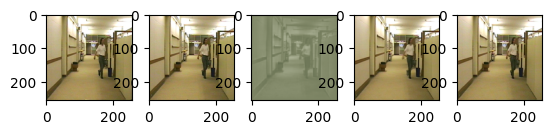

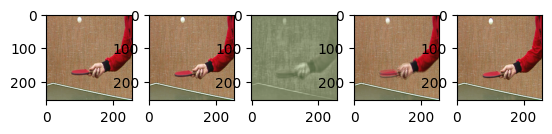

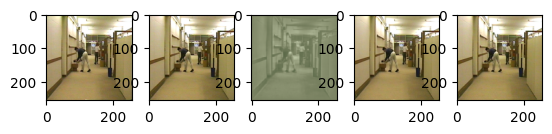

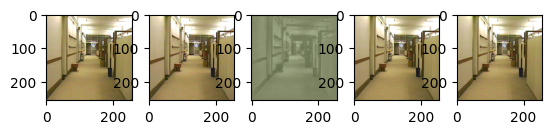

RealLoss= tensor(0.3909, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5001, 0.5008, 0.5001, 0.5001, 0.5001, 0.5001, 0.5004,
        0.5002, 0.5001, 0.5002, 0.5001, 0.5002, 0.5002, 0.5001, 0.5001, 0.5001,
        0.5001, 0.5001, 0.5005, 0.5001, 0.5003, 0.5001, 0.5001, 0.5001, 0.5001,
        0.5001, 0.5001, 0.5003, 0.5002, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.2805, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3008, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0128, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.3899, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6935, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5003, 0.5001, 0.5002, 0.5001, 0.5001, 0.5002, 0.5001, 0.5001,
        0.5001, 0.5001, 0.5000, 0.

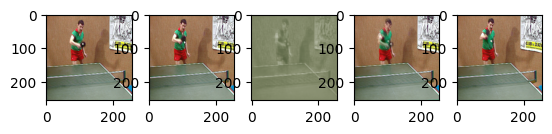

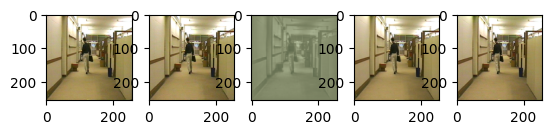

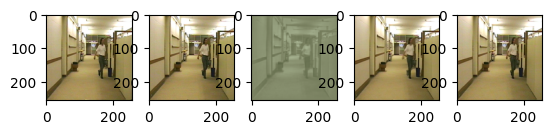

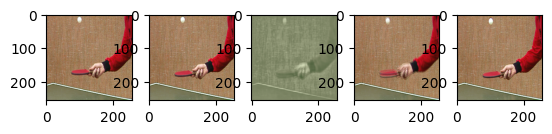

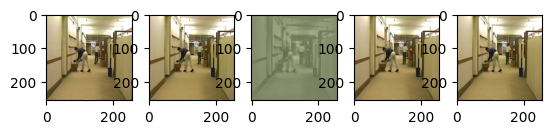

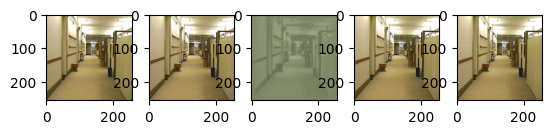

RealLoss= tensor(0.3868, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6931, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5002, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5002, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000,
        0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5003, 0.5000, 0.5000, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.2958, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3094, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0130, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.3863, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5001, 0.5000, 0.5005, 0.5000, 0.5000, 0.5001, 0.5000,
        0.5001, 0.5001, 0.5002, 0.

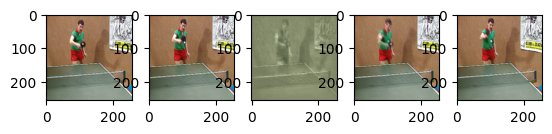

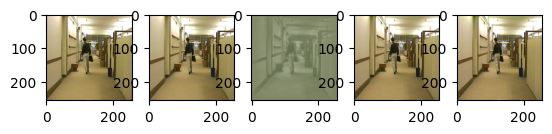

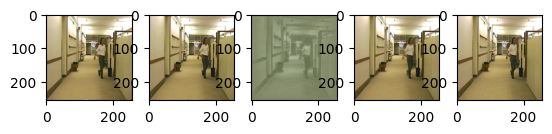

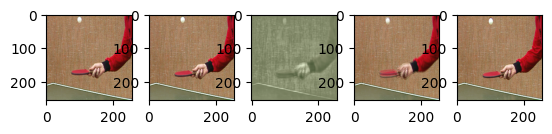

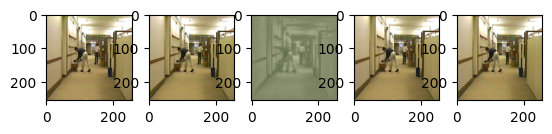

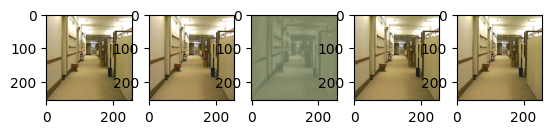

RealLoss= tensor(0.3831, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5004, 0.5004, 0.5004, 0.5003, 0.5002, 0.5004, 0.5002, 0.5002, 0.5012,
        0.5004, 0.5008, 0.5004, 0.5004, 0.5004, 0.5004, 0.5004, 0.5004, 0.5003,
        0.5004, 0.5004, 0.5005, 0.5004, 0.5004, 0.5004, 0.5004, 0.5004, 0.5004,
        0.5004, 0.5004, 0.5004, 0.5005, 0.5004], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.2869, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.3002, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0130, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.3833, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6942, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5003, 0.5008, 0.5004, 0.5005, 0.5003, 0.5006, 0.5024, 0.5005, 0.5012,
        0.5007, 0.5003, 0.5006, 0.

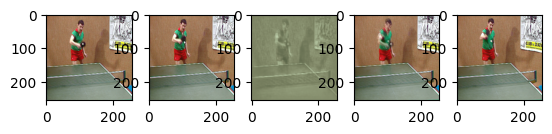

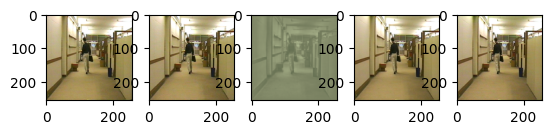

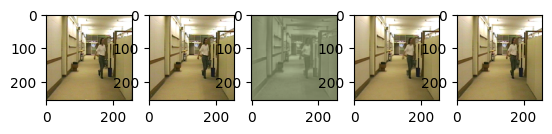

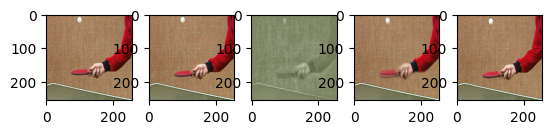

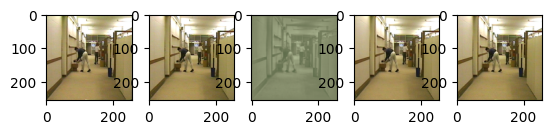

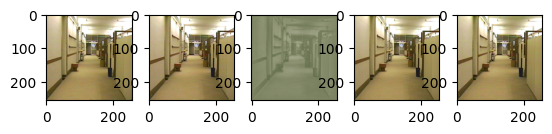

RealLoss= tensor(0.3807, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5001, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5001, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5001,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.2748, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2925, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0132, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.3791, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.

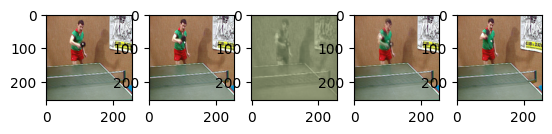

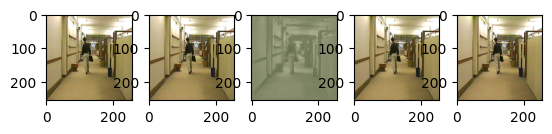

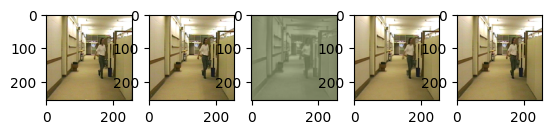

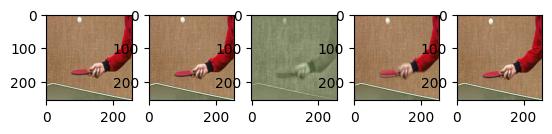

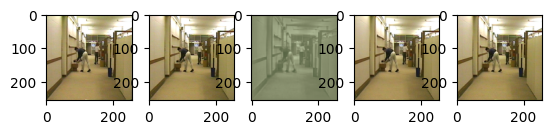

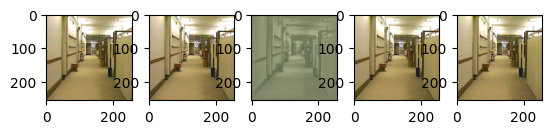

RealLoss= tensor(0.3762, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5004, 0.5000, 0.5000, 0.5000, 0.5001, 0.5001, 0.5000, 0.5000,
        0.5001, 0.5000, 0.5001, 0.5000, 0.5001, 0.5001, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000,
        0.5001, 0.5002, 0.5001, 0.5001, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.2676, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2882, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0134, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.3751, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5001,
        0.5001, 0.5000, 0.5000, 0.

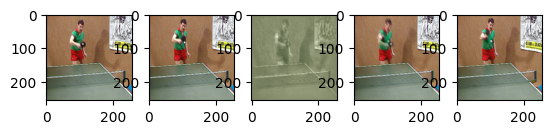

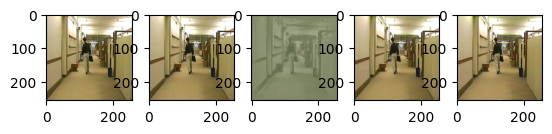

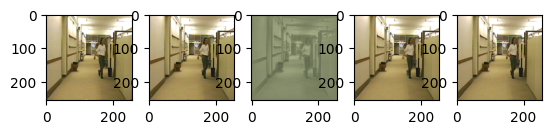

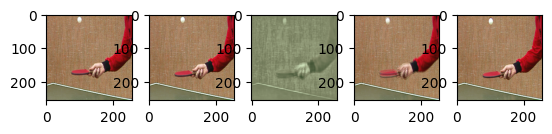

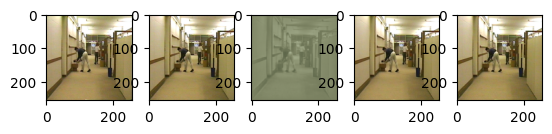

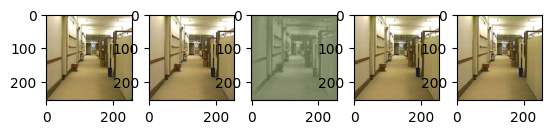

RealLoss= tensor(0.3720, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000,
        0.5002, 0.5000, 0.5003, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5001,
        0.5000, 0.5000, 0.5001, 0.5000, 0.5009, 0.5000, 0.5000, 0.5002, 0.5013,
        0.5001, 0.5000, 0.5000, 0.5000, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.2431, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2665, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0135, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.3715, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.

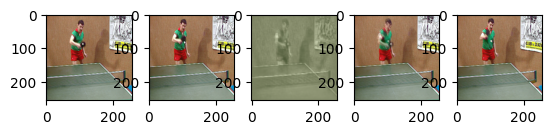

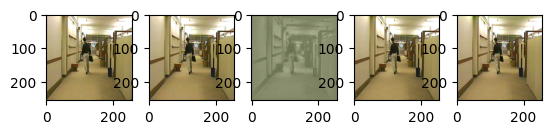

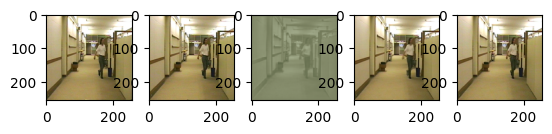

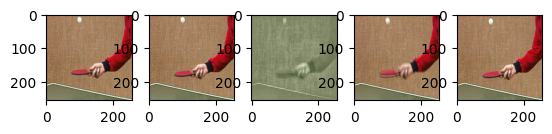

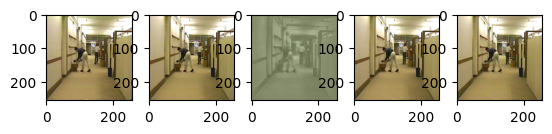

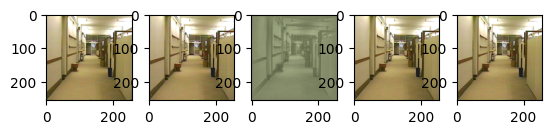

RealLoss= tensor(0.3685, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5003, 0.5000, 0.5000, 0.5002, 0.5001, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5004, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5002, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5008, 0.5000,
        0.5000, 0.5000, 0.5001, 0.5000, 0.5002], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.2597, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2752, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0135, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.3671, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.

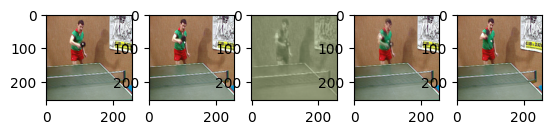

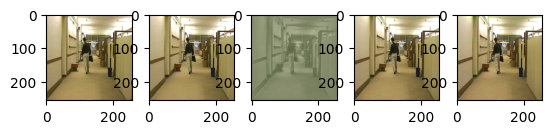

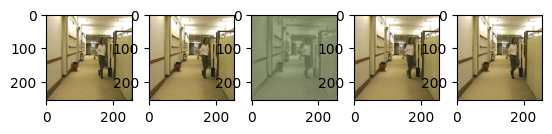

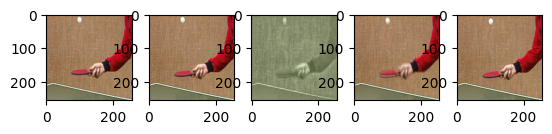

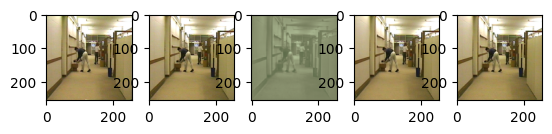

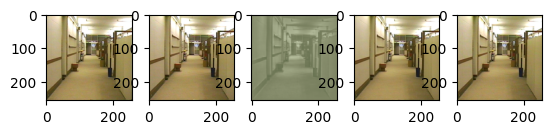

RealLoss= tensor(0.3656, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6935, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5005, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5002,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5001, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5002, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.2248, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2611, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0141, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.3645, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6931, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.

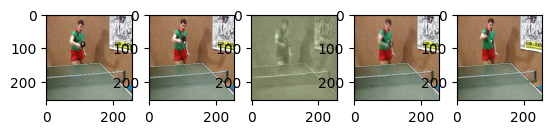

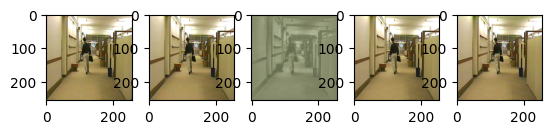

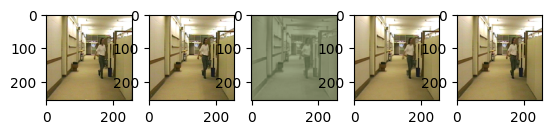

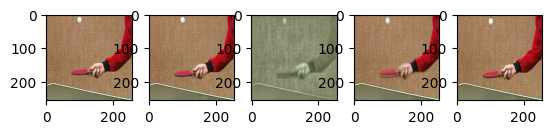

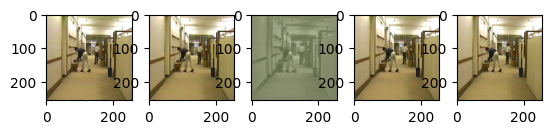

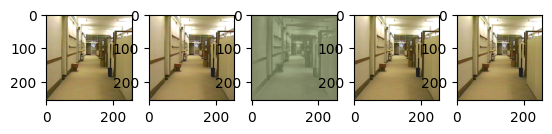

RealLoss= tensor(0.3616, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5001, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5001, 0.5000,
        0.5000, 0.5002, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5001, 0.5005, 0.5000, 0.5000, 0.5006, 0.5000, 0.5000,
        0.5001, 0.5000, 0.5003, 0.5001, 0.5001], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.2190, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2486, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0140, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.3604, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5000, 0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5001, 0.5000, 0.

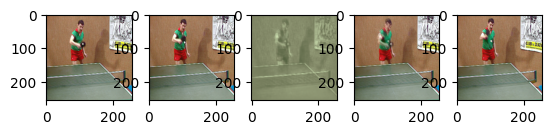

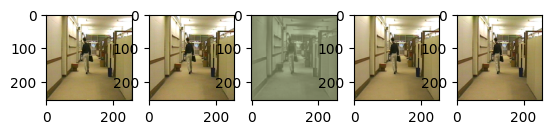

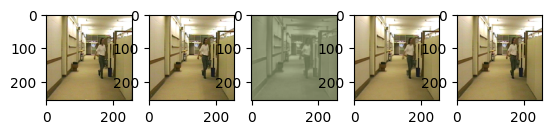

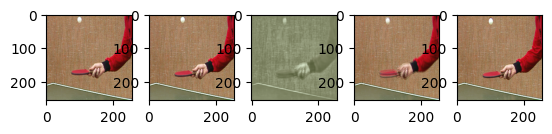

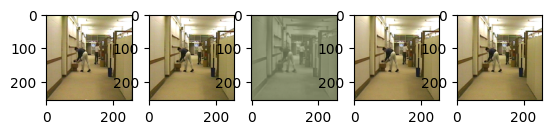

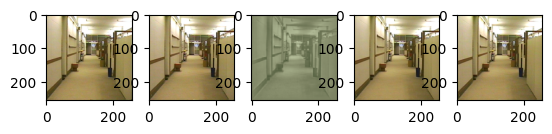

RealLoss= tensor(0.3570, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5002, 0.5000, 0.5000, 0.5002, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5010, 0.5000, 0.5001, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5001, 0.5002, 0.5000, 0.5000, 0.5001, 0.5000,
        0.5001, 0.5001, 0.5000, 0.5001, 0.5000], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.2339, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2543, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0146, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.3566, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6933, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5000, 0.5001, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5001, 0.5000,
        0.5000, 0.5000, 0.5000, 0.

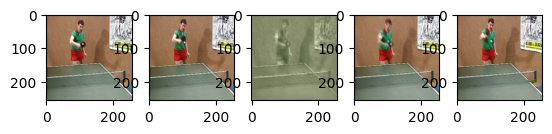

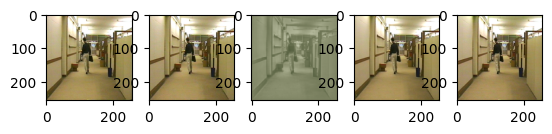

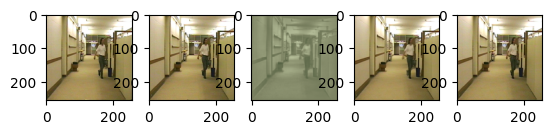

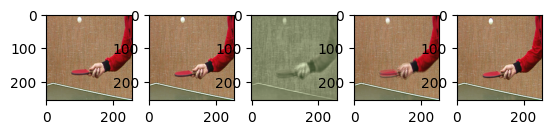

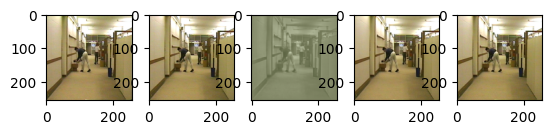

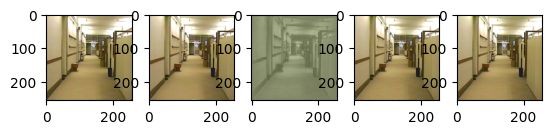

RealLoss= tensor(0.3567, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6932, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5001, 0.5003, 0.5002, 0.5002, 0.5001, 0.5001, 0.5005, 0.5007, 0.5004,
        0.5002, 0.5004, 0.5002, 0.5003, 0.5002, 0.5001, 0.5002, 0.5003, 0.5002,
        0.5002, 0.5002, 0.5006, 0.5002, 0.5002, 0.5002, 0.5002, 0.5001, 0.5005,
        0.5001, 0.5005, 0.5002, 0.5002, 0.5003], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
TotalGEN_LOSS= tensor(1.2155, device='cuda:0', grad_fn=<AddBackward0>) MSSSIM= tensor(0.2491, device='cuda:0', grad_fn=<RsubBackward1>) Clip= tensor(0.0140, device='cuda:0', grad_fn=<MseLossBackward0>)
RealLoss= tensor(0.3544, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>) FakeLoss= tensor(0.6938, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
preds: tensor([0.5005, 0.5009, 0.5002, 0.5001, 0.5001, 0.5003, 0.5003, 0.5011, 0.5002,
        0.5002, 0.5006, 0.5002, 0.

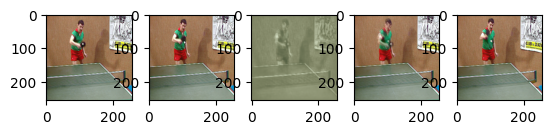

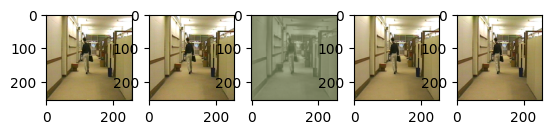

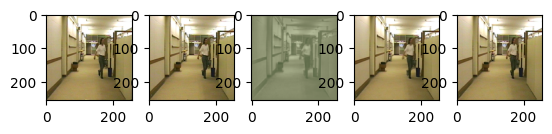

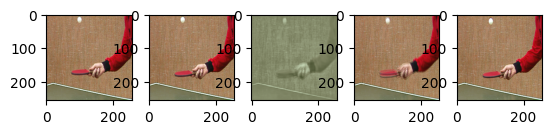

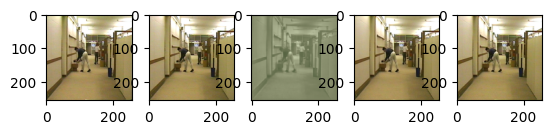

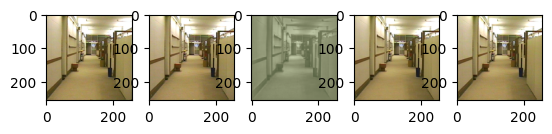

In [36]:
lossG, lossD, RS, FS = train(Num_Epochs,Lr)

In [42]:
torch.save(gen.state_dict(),'/content/FiNNiGAN-Implementation/logs/GenFin.pth')
torch.save(disc.state_dict(),'/content/FiNNiGAN-Implementation/logs/DISFin.pth')

[]

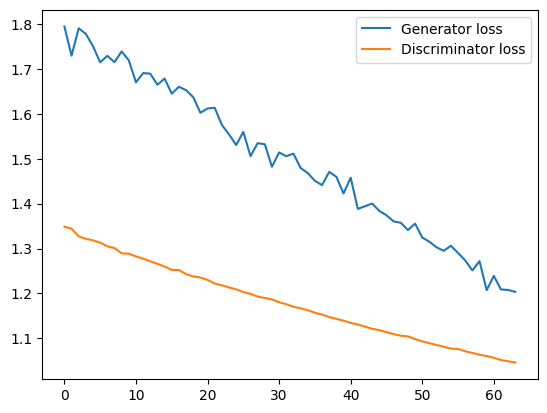

In [50]:
plt.plot(lossG,label='Generator loss')
plt.plot(lossD,label='Discriminator loss')
plt.legend()
plt.plot()

[]

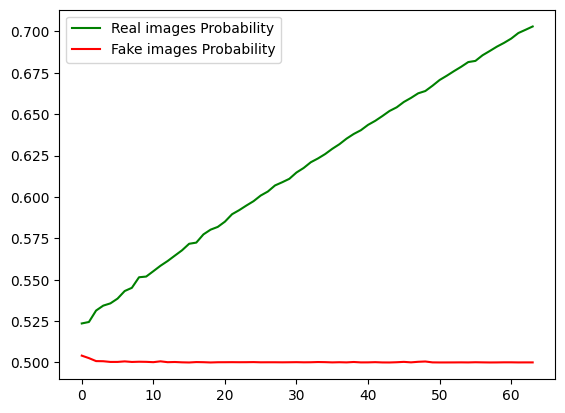

In [56]:
plt.plot(RS,label='Real images Probability',color='green')
plt.plot(FS,label='Fake images Probability',color='red')
plt.legend()
plt.plot()

# Testing on The Test Data:

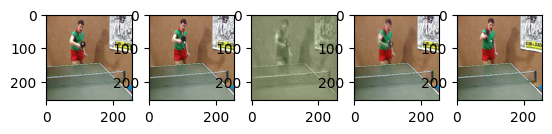

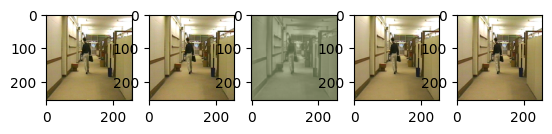

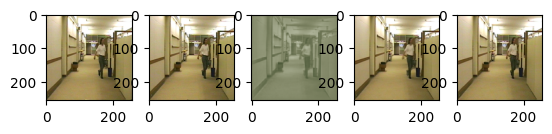

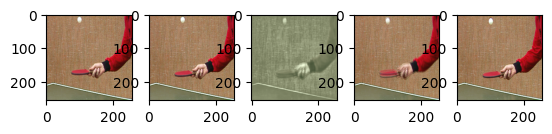

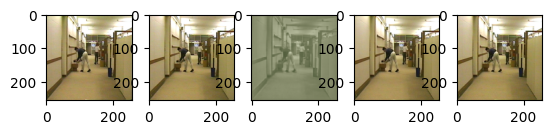

...

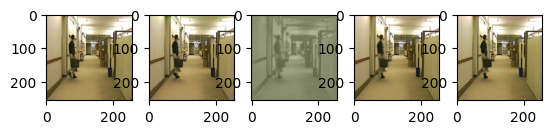

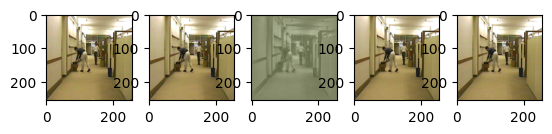

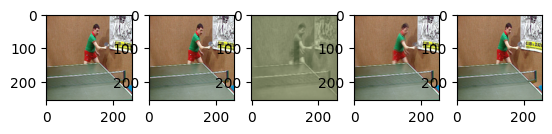

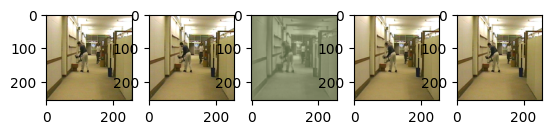

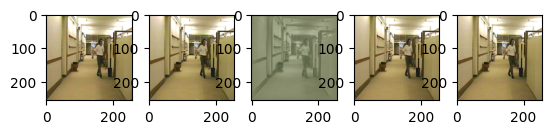

In [57]:
def showImg(idx):
    t1,t2,Img1,Img2 = test_set[idx]
    t1.to(device)
    t2.to(device)
    Img1.to(device)
    Img2.to(device)
    T1 = torch.unsqueeze(t1,dim=0).to(device)
    genout = gen(T1).to(device)
    genout = torch.squeeze(genout,dim=0).to(device)
    f , axarr = plt.subplots(1,5)
    axarr[0].imshow(denorm(Img1).permute(1,2,0))
    axarr[1].imshow(denorm(t2).permute(1,2,0))
    with torch.no_grad():
        axarr[2].imshow(denorm(genout.to('cpu')).permute(1,2,0))
    axarr[3].imshow(denorm(t1).permute(1,2,0))
    axarr[4].imshow(denorm(Img2).permute(1,2,0))
    f.show()
    plt.show(block=True)

for i in range(int(len(test_set))):
    showImg(i)

# Loading The MODEL:



In [ ]:
###